# Part 1: Motivation

## What is our data set?

For this project it was decided to work with IMDB data. 
IMDB provides a subset of their data to everyone who might be interesting in analyzing it. The data provided by IMDB are split into multiple files, not all of these files are used for this project.
The files used for this project is:
name.basics.tsv.gz
title.akas.tsv.gz
title.basics.tsv.gz
title.crew.tsv.gz
title.episode.tsv.gz
title.principals.tsv.gz
title.ratings.tsv.gz
The file "title.principals" is the main datafile, which orignally consists of 1.3 Gb of data with 30.674.812 rows and 6 columns.
These datafiles contains information about movies, actors in those movies, when they movies were made, what the different peoples roles were in the movies, ID of movies and actors, type of movie such as tv show or movie and ratings of these movies.

Besides these data files, some files containing reviews of movies were also used. These reviews were downloaded from the website Kaggle.com and consists of 100.000 reviews on 14.127 movies.
The reviews from Kaggle are divided into two folders, each containing 50.000 reviews. Sentiment analysis has already been conducted on some of the reviews, however this was ignored for this project. 
Besides the moview reviews the data also contains URLS describing which movie the different reviews come from, this is the part linking the movies with the reviews.

## Why did you chose this/ these particular datasets

The datasets chosen for this project provides with a way to link actors to each other through their movies. Besides this it also provides reviews for the movies, such that sentiment analysis can be done on these in order to link the sentiment score of the movies actors has been in, to the actors. 

Some of the data files are also used when cleaning the data and making it more suitable for the project, this was especially important since the data set was very large initially.

All of these data files therefore provides everything needed in order to make this project, which is why they were chosen.

## What was your goal for the end user's experience?

The goal of this project is to find communities of actors/actresses which are enjoyable together. The project is therefore not about find good movies, but instead finding out which actors/actresses make good movies when working together.

It is therefore possible for an actor to have bad reviews in general, but still being enjoyable to watch when paired up with certain actors/actresses.

# Part 2: Data preparation

We have two type of data:
* reviews
* IMBD databases containing actors, movies and rating <br>

The databases contains alot of irrelevant information such as games and movies with no reviews in the review data set. Therefore we first have to clean our databases in order to keep only the relevant information.

In this we also comment the different methods and tools used for data cleaning.

## Preparation for data cleaning

### Execution style

In [1]:
startFromCleanData = True #Start with the raw data imported or the cleaned files
fastExecution = False     #Use the stored graph, position and DF of rebuild them
savingFigures = True      #Whether to save or not the figures produced

### Libraries

In [2]:
# Import Libraries
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import re
import fa2
import math
import community
import matplotlib.cm as cm
from __future__ import division
import matplotlib.image as mpimg
from nltk.tokenize import RegexpTokenizer
from nltk.corpus import stopwords
import io
from collections import Counter
from wordcloud import WordCloud
from scipy.special import zeta
import pickle
# Rendering Parameters
title_font = {'family': 'sans-serif',
        'color':  '#000000',
        'weight': 'normal',
        'size': 16,
        }
#COLORS
mBlue = "#55638A"     # For actor
fRed = "#9E1030"    # For actress

## Object Storage

In [3]:
#PICKLE
def save_obj(obj, name ):
    with open('obj/'+ name + '.pkl', 'wb') as f:
        pickle.dump(obj, f, pickle.HIGHEST_PROTOCOL)

def load_obj(name ):
    with open('obj/' + name + '.pkl', 'rb') as f:
        return pickle.load(f)
        

We decided to use Pickle as our data frame, because it is native to pandas and also because the Pickle data frame structure is more compressed than txt files and allows for much faster reading of files.

## Initialise Actors and Movie Dictionnaries

In [4]:
###################################
# Initialise a movie dictionnary
###################################

# Function. to convert movie or actor id to sting key
def idToString(iD, base): # base = "tt" for movies or "nm" for actors
    if iD<10:
        return base+"000000"+str(iD)
    if iD<100:
        return base+"00000"+str(iD)
    if iD<1000:
        return base+"0000"+str(iD)
    if iD<10000:
        return base+"000"+str(iD)
    if iD<100000:
        return base+"00"+str(iD)
    if iD<1000000:
        return base+"0"+str(iD)
    else:
        return base+str(iD)
    
# Create movie dictionnary
movieDict = {}
lastMovie = 9999999 #last movie ID
if not fastExecution:
    for i in range(lastMovie):
        movieDict[idToString(i+1,"tt")] = False
    print "Movie Dictionnary initialised"
else:
    print "Fast execution mode, movie dictionnary will be initialised later"
    

Movie Dictionnary initialised


We decided to use dictionaries, when checking which movies and actors we want to save in our data. This is because dictionaries provide an easy way to save each movie ID and actor ID as a key in the dictionary and having the value of that key as either True or false, depending if it should be kept or not.
Another reason why we decided on using dictionaries are that dictionaries is faster to use when running code.

In [5]:
###################################
# Get the movies to keep
###################################

# List of the reviews documents
listReviewsDocuments = ["train/urls_neg.txt","test/urls_neg.txt","train/urls_pos.txt","test/urls_pos.txt","train/urls_unsup.txt"]

# Fill in the dictionnary
for document in listReviewsDocuments:
    files = io.open("aclImdb/"+document, mode="r", encoding="utf-8")
    for row in files:
        w = re.findall(r'http://www.imdb.com/title/(\w*)/usercomments',row)
        movieDict[w[0]] = True


Throughtout this project all data is encoded and decoded with unicode. The reason for this is that the data used for this project is already encoded in unicode. It is therefore the obvious choice to keep the same formate when handling the text, throughout the project.

In [6]:
###################################
# Create an Actor Dict
###################################
actorDict = {}
lastActor = 29999999 #last movie ID
for i in range(lastActor):
    actorDict[idToString(i+1,"nm")] = False
print "Actor Dictionnary initialised"

Actor Dictionnary initialised


## Data Cleaning

After this setup the data is ready to be cleaned.
The way the data was cleaned was to only save data which is relevant for this project. First it was relevant to only save movies which has reviews and which are actually movies and not games, tv shows etc.

In [7]:
###################################
# key to movie name file
###################################

if not startFromCleanData:
    path = "DATA/title.basics.txt"
    cleanPath = "DATA/title.basics.clean.txt"
    files = io.open(path, mode="r", encoding="utf-8")
    cleanfile = io.open(cleanPath, mode="w", encoding="utf-8")
    b=False # skip the first line
    count =0
    for row in files:
        if b:
            split=row.split("\t")
            key = split[0]
            if movieDict[key]:
                if (split[1] in ['movie', 'tvMovie']):
                    cleanfile.write(row)
                    count +=1
                else:
                    movieDict[key]=False
        else:
            b=True
    files.close()
    cleanfile.close()


    print "There are "+str(count)+" movies considered"
    print "DATA/title.basics.txt cleaned"

After this step, only actors and actresses in the remaining movies should be saved, everyone not in the movies or with another role than actor/actress where therefore removed.

In [8]:
##########################################################
# film actors links file : Clean + get actor dictionnary
##########################################################

if not startFromCleanData:
    path = "DATA/title.principals.txt"
    cleanPath = "DATA/title.principals.clean.txt"
    files = io.open(path, mode="r", encoding="utf-8")
    cleanfile = io.open(cleanPath, mode="w", encoding="utf-8")
    roleCheckList = ["actor", "actress", "self"] #check if it is an actor
    nLinks = 0
    i=False # skip first line
    for row in files:
        if i:
            split = row.split("\t") 
            key = split[0]
            if movieDict[key]:
                if (split[3] in roleCheckList or split[4] in roleCheckList or split[5] in roleCheckList):
                    cleanfile.write(row)
                    actorDict[split[2]]=True
                    nLinks  +=1

        else:
            i=True

    files.close()
    cleanfile.close()

    ##REMOVE ERRORS
    actorDict["nm0547707"]=False
    actorDict['nm0547707']=False
    actorDict['nm0809728']=False
    actorDict['nm2442859']=False
    actorDict['nm1996613']=False
    actorDict['nm0600636']=False
    actorDict['nm1824417']=False
    actorDict['nm2440192']=False
    actorDict['nm1754167']=False

    print "There are "+str(nLinks-9)+" actors considered"
    print "DATA/title.principals.txt cleaned"

In [9]:
###################################
# key to actor name file
###################################

if not startFromCleanData:
    path = "DATA/name.basics.txt"
    cleanPath = "DATA/name.basics.clean.txt"
    files = io.open(path, mode="r", encoding="utf-8")
    cleanfile = io.open(cleanPath, mode="w", encoding="utf-8")
    count = 0
    i=False
    for row in files:
        if i:
            split = row.split("\t")
            key = split[0]
            if actorDict[key]:
                cleanfile.write(row)
        else:
            i=True

    files.close()
    cleanfile.close()
    print "DATA/name.basics.txt cleaned"

## Clean Data Pre-Processing

Once everything not relevant for the project has been removed and only relevant movies and actors/acresses remain, it is then necessary to initialize all of this data, in order to gather relevant information about the data such as movie years etc.

In [10]:
############################################
# Preprocess Movie Dict and get movie years
############################################

movieAgeDict = {}

path = "DATA/title.basics.clean.txt"
files = io.open(path, mode="r", encoding="utf-8")
count =0
for row in files:
    split=row.split("\t")
    key = split[0]
    if movieDict[key]:
        if (split[1] in ['movie', 'tvMovie']) and not (split[5] == "\\N"):
            movieAgeDict[key] = int(split[5])
            count +=1
files.close()

#Clean Movie dict
for i in range(lastMovie):
    movieDict[idToString(i+1,"tt")] = False

for key in movieAgeDict.keys():
    movieDict[key]=True


print "There are "+str(count)+" movies considered"
print "Movie Dictionnary Preprocessed and Movie Age Dictionnary Built"
    

There are 10735 movies considered
Movie Dictionnary Preprocessed and Movie Age Dictionnary Built


In [11]:
##########################################################
# film actors links file : Clean + get actor dictionnary
##########################################################

path = "DATA/title.principals.clean.txt"
files = io.open(path, mode="r", encoding="utf-8")
roleCheckList = ["actor", "actress", "self"] #check if it is an actor
nLinks = 0
for row in files:
    split = row.split("\t") 
    key = split[0]
    if movieDict[key]:
        if (split[3] in roleCheckList or split[4] in roleCheckList or split[5] in roleCheckList):
            actorDict[split[2]]=True
            nLinks  +=1

files.close()

###REMOVE ERRORS
actorDict["nm0547707"]=False
actorDict['nm0547707']=False
actorDict['nm0809728']=False
actorDict['nm2442859']=False
actorDict['nm1996613']=False
actorDict['nm0600636']=False
actorDict['nm1824417']=False
actorDict['nm2440192']=False
actorDict['nm1754167']=False

print "There are "+str(nLinks-9)+" actors considered"

print "Actor Dictionnary Preprocessed"
    

There are 43553 actors considered
Actor Dictionnary Preprocessed


In [12]:
###################################
# Create a ratings dict
###################################
ratingDict = {}
path = "DATA/ratings.txt"
files = io.open(path, mode="r", encoding="utf-8")
count = 0
i=False # skip first line
for row in files:
    if i:
        key = row[:9]
        if movieDict[key]:
            split = row.split("\t") 
            ratingDict[key] = float(split[1])
    else:
        i=True

files.close()

In [13]:
###################################
# Create a movie name dict
###################################
movieNameDict = {}
moviesList = []
path = "DATA/title.akas.clean.txt"
files = io.open(path, mode="r", encoding="utf-8")
count = 0
for row in files:
    split = row.split("\t") 
    if movieDict[split[0]] and not (split[0] in movieNameDict) and (split[0] in ratingDict) and "original" in row   :
        movieNameDict[split[0]] = split[2]
        moviesList.append(split[0])

files.close()

In [14]:
###################################
# Create an actor name dict
###################################
actorNameDict = {}
actorGenderDict = {}
actorsList = []
path = "DATA/name.basics.clean.txt"
files = io.open(path, mode="r", encoding="utf-8")
count = 0
for row in files:
    split = row.split("\t") 
    if actorDict[split[0]] and not (split[0] in actorNameDict):
        actorNameDict[split[0]] = split[1]
        if "actor" in split[4]:
            actorGenderDict[split[0]] = "M"
        else:
            actorGenderDict[split[0]] = "F"
        actorsList.append(split[0])
files.close()

In [20]:
###################################
# Build a movie data frame
###################################
if not fastExecution:
    moviesData = {"iD" : movieNameDict.keys(), "Title": pd.Series(np.zeros(len(moviesList))), "Rating":pd.Series(np.zeros(len(moviesList))), "Year":pd.Series(np.zeros(len(moviesList)))}
    moviesDF = pd.DataFrame(moviesData)
    for i in moviesDF.index:
        iD =moviesDF.loc[i].at["iD"]
        moviesDF.loc[i, "Title"]= movieNameDict[iD]
        moviesDF.loc[i, "Rating"] = ratingDict[iD]
        moviesDF.loc[i, "Year"]= movieAgeDict[iD]
    if savingFigures:
        moviesDF.to_pickle("obj/moviesDF.pkl")
else:
    moviesDF = pd.read_pickle("obj/moviesDF.pkl")
moviesDF.sort_values("Rating", ascending=False).head(10)

,Rating,Title,Year,iD
8686,9.1,The Regard of Flight,1983.0,tt0134050
7737,9.0,Notre-Dame de Paris,1999.0,tt0285800
8377,8.9,Ko to tamo peva,1980.0,tt0076276
4887,8.9,12 Angry Men,1957.0,tt0050083
9860,8.9,Schindler's List,1993.0,tt0108052
1157,8.9,The Lord of the Rings: The Return of the King,2003.0,tt0167260
8305,8.8,Saban Oglu Saban,1977.0,tt0253614
1389,8.8,Sobache serdtse,1988.0,tt0096126
2151,8.8,The Art of Amália,2000.0,tt0204839
9079,8.8,The Lord of the Rings: The Fellowship of the Ring,2001.0,tt0120737


When the data has been cleaned, the remaining data for the movies are their rating, movie title, which year it was made and the movie ID. 

This data is everything needed in order to link it to the actors and the different reviews as well as categorizing them after year and analyzing ratings.

In [22]:
###################################
# Build an actor data frame
###################################
if not fastExecution:
    actorsData = {"iD": actorNameDict.keys(), "Name": pd.Series(np.zeros(len(actorsList))),"Gender": pd.Series(np.zeros(len(actorsList)))}
    actorsDF = pd.DataFrame(actorsData)
    for i in actorsDF.index:
        iD = actorsDF.loc[i].at["iD"]
        actorsDF.loc[i, "Name"]= actorNameDict[iD]
        actorsDF.loc[i, "Gender"] = actorGenderDict[iD]
    if savingFigures:
        actorsDF.to_pickle("obj/actorsDF.pkl")
else:
    actorsDF = pd.read_pickle("obj/actorsDF.pkl")
actorsDF.head(10)

,Gender,Name,iD
0,F,Bobbie Bresee,nm0107679
1,F,Malgorzata Rozniatowska,nm0747647
2,M,Ahmet Ugurlu,nm0880128
3,F,Laura Nativo,nm1137466
4,F,Jordy Benattar,nm0070237
5,M,Özkan Ugur,nm0880126
6,M,John Foss,nm1458561
7,M,Panayiotis Hartomatzidis,nm0367186
8,M,Simon Abkarian,nm0008787
9,F,Victoria Snow,nm0795281


For actors and actresses the only relevant information was their gender, name and IMDB ID which is used when linking them to the movies. 

In [17]:
###################################
# Create a links list
###################################
path = "DATA/title.principals.clean.txt"
files = io.open(path, mode="r", encoding="utf-8")
links = np.empty((nLinks,2),dtype=object)
count = 0
for row in files:
    split = row.split("\t")
    if actorDict[split[2]]:
        links[count,0]= split[0]
        links[count,1]= split[2]
        count+=1

files.close()

In [23]:
###################################
# Create an actor links list
###################################
actorsLinks = []
files = io.open("obj/actorsLinksList.txt", mode="w", encoding="utf-8")
for i in range(count-1):
    j = i+1
    while (j<count) and (links[i,0]==links[j,0]):
        actorsLinks.append([links[i,1],links[j,1],links[i,0]]) #[actor1, actor2, movie]
        files.write(str(links[i,1])+"\t"+str(links[j,1])+"\t"+links[i,0]+"\r\n")
        j+=1
files.close()

## LOAD & CLEAN DATA FUNCTION 

In [25]:
def cleanLoadData():
    
    #build the Dataframes
    mDF = pd.read_pickle("obj/moviesDF.pkl")
    aDF = pd.read_pickle("obj/actorsDF.pkl")
    aLL = []
    files = io.open("obj/actorsLinksList.txt", mode="r", encoding="utf-8")
    for row in files:
        split = row.split("\t")
        aLL.append(split)
    files.close()
    
    #rebuild the Dictionnary
    movieAgeDict = {}
    ratingDict = {}
    actorName = {}
    movieName = {}
    #movies
    for i in mDF.index:
        iD = mDF.loc[i].at["iD"]
        rating = mDF.loc[i].at["Rating"]
        title = mDF.loc[i].at["Title"]
        year = mDF.loc[i].at["Year"]
        movieAgeDict[iD] = year
        ratingDict[iD] = rating
        movieName[iD] = title
    #actors
    for i in aDF.index:
        iD = aDF.loc[i].at["iD"]
        name = aDF.loc[i].at["Name"]
        actorName[iD]= name
    return movieAgeDict,ratingDict,actorName,movieName,mDF,aDF,aLL
    

Once the data has been cleaned and saved into files, all there is left to do is load the data and use it in the rest of the project. 

## Cleaned data stats

As mentioned in the "What is our data set" chapter the original data consists of over 30 million rows and 1.3 Gb of data.
The cleaned data ends up being around 44.000 rows with a size of 2.1Mb. which is approximately 0,15% of the original data.

# Part 3: Tools, theory and analysis

### Execution Style

In [1]:
fastExecution = True       # Whether to use or not pre build short-cut files to skip long execution bloc of codes
savingFigures = False      # Whether to save or not the figures produced
savingData = False         # Whether to build or not the short cut files for future fastExecution

### Libraries

In [2]:
# Import Libraries
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import json
import re
import fa2
import math
import community
import matplotlib.cm as cm
import pickle
from __future__ import division
import matplotlib.image as mpimg
from nltk.tokenize import RegexpTokenizer
from nltk.corpus import stopwords
import io
from collections import Counter
from wordcloud import WordCloud
from scipy.special import zeta
# Rendering Parameters
title_font = {'family': 'sans-serif',
        'color':  '#000000',
        'weight': 'bold',
        'size': 28,
        }
#COLORS
mBlue = "#55638A"     # For actor
fRed = "#9E1030"    # For actress

## Get the cleaned Data

The cleaning and preprocessing of data can be found in [Explainer notebook part 1 and 2](http://nbviewer.jupyter.org/github/s134265/socialgraphs2018/blob/master/Project/Explainer%20notebook%20part%201%20and%202.ipynb). 

Here we get the movies and actors data frames (moviesDF,actorsDF), the movie age dictionnary (movieAgeDict), the rating one (ratingDict), the movies and actors names dictionnaries (actorNameDict,movieNameDict) and one list containing all the collaboration between actors (actorsLinks)

In [3]:
from loadData import cleanLoadData
movieAgeDict,ratingDict,actorNameDict,movieNameDict,moviesDF,actorsDF,actorsLinks = cleanLoadData()

#### Actors Data Frame

In [4]:
actorsDF.head(10)

,Gender,Name,iD
0,F,Bobbie Bresee,nm0107679
1,F,Malgorzata Rozniatowska,nm0747647
2,M,Ahmet Ugurlu,nm0880128
3,F,Laura Nativo,nm1137466
4,F,Jordy Benattar,nm0070237
5,M,Özkan Ugur,nm0880126
6,M,John Foss,nm1458561
7,M,Panayiotis Hartomatzidis,nm0367186
8,M,Simon Abkarian,nm0008787
9,F,Victoria Snow,nm0795281


#### Movies Data Frame

In [5]:
moviesDF.sort_values("Rating", ascending=False).head(10)

,Rating,Title,Year,iD
8686,9.1,The Regard of Flight,1983.0,tt0134050
7737,9.0,Notre-Dame de Paris,1999.0,tt0285800
8377,8.9,Ko to tamo peva,1980.0,tt0076276
4887,8.9,12 Angry Men,1957.0,tt0050083
9860,8.9,Schindler's List,1993.0,tt0108052
1157,8.9,The Lord of the Rings: The Return of the King,2003.0,tt0167260
8305,8.8,Saban Oglu Saban,1977.0,tt0253614
1389,8.8,Sobache serdtse,1988.0,tt0096126
2151,8.8,The Art of Amália,2000.0,tt0204839
9079,8.8,The Lord of the Rings: The Fellowship of the Ring,2001.0,tt0120737


## Actors Graph

We choose to build a graph where the nodes are the actors, and the links represent the collaboration between two actors: the movies they both participate in, the ratings they got and the average year of their collaborations

In [6]:
##########################
# Create the actors Graph
##########################
G = nx.Graph()
#add nodes
for i in actorsDF.index:
    G.add_node(actorsDF.loc[i].at["iD"], Name= actorsDF.loc[i, "Name"], Gender = actorsDF.loc[i, "Gender"])


#add links
for link in actorsLinks:
    if link[0]  != link[1]: 
        if G.has_edge(link[0],link[1]):  #Update existing edges                       
            G[link[0]][link[1]]["weight"] +=1 
            G[link[0]][link[1]]["movies"].append(link[2])
            #Average Rating
            avRating = (G[link[0]][link[1]]["avRating"])*(1-1.0/G[link[0]][link[1]]["weight"]) #Former ratings
            avRating += ratingDict[link[2]]/G[link[0]][link[1]]["weight"]  # Added Movie
            G[link[0]][link[1]]["avRating"] = avRating
            #Average Year
            avYear = (G[link[0]][link[1]]["avYear"])*(1-1.0/G[link[0]][link[1]]["weight"]) #Former ratings
            avYear += movieAgeDict[link[2]]/G[link[0]][link[1]]["weight"]  # Added Movie
            G[link[0]][link[1]]["avYear"] = avYear
        else: #Create new edge
            G.add_edge(link[0], link[1], 
                       weight = 1, 
                       movies = [link[2]], 
                       avRating = ratingDict[link[2]], 
                       avYear = movieAgeDict[link[2]]) 

### Clean the graph

We took the giant component to have a connected graph to study.

In [7]:
##################
# Clean the Graph
##################

G =  max(nx.connected_component_subgraphs(G), key=len)
if savingData:
    nx.write_gpickle(G, 'obj/full.gpickle') 
    
print "The graph has "+str(G.number_of_nodes())+" nodes (actors) and "+str(G.number_of_edges())+" edges (collaborations)"

The graph has 15950 nodes (actors) and 52727 edges (collaborations)


### Visualize the graph

In [8]:
#################################################
# Set the node colors actording to actors gender
#################################################

def getColors(graph):
    mBlue = "#55638A"     # For actor
    fRed = "#9E1030"    # For actress
    colors = {}  # Build the color 
    k=0
    for n in graph.nodes:
        if graph.nodes[n]['Gender'] == "F":    
            colors[n]= fRed
        else:
            colors[n]= mBlue
    return colors

We use separate colors for men and women to see if they have different influence in the graph.

In [9]:
###############################################
# Set the edge colors actording to movie years
###############################################

def getEdgeColors(graph):
    c1930 = "#c12424"
    c1955 = "#ff6612"
    c1980 = "#ffce00"
    c1995 = "#e3f018"
    cNow = "#bdff00"
    edgesColors = {}  
    for e in G.edges:
        edgesColors[e] = c1930  #RED
        if graph.get_edge_data(*e)["avYear"]>1930:
            edgesColors[e] = c1955 #ORANGE      
        if graph.get_edge_data(*e)["avYear"]>1955:
            edgesColors[e] = c1980 #YELLOW
        if graph.get_edge_data(*e)["avYear"]>1980:
            edgesColors[e] = c1995 #LIGHT GREEN
        if graph.get_edge_data(*e)["avYear"]>1995:
            edgesColors[e] = cNow #GREEN
    return edgesColors

The edges will have colors according to the average year of the two actors collaborations, from red for old movies to green for the most recent ones. With this can show how the age is important in this network.

In [10]:
###########################################################
# Set the size of the nodes according to outgoing strength
###########################################################

sizes = {}
actorsDF["Collab"] = pd.Series(np.zeros(len(actorsDF.index))) #to store the outgoing strength
for i in actorsDF.index: # go through actors
    iD =actorsDF.loc[i].at["iD"]
    if iD in G.nodes(): # if actor in the grpah
        edges = list(G.edges(iD)) 
        ogStrength = 0
        for e in edges: # go though his edges
            ogStrength += G.get_edge_data(*e)["weight"]  #update outgoing strength
        actorsDF.loc[i, "Collab"]= ogStrength 
        sizes[iD] = ogStrength
    else :
        actorsDF.loc[i, "Collab"]= 0
actorsDF=actorsDF.sort_values("Collab", ascending=False) #Sort actors DF

In this network, the outgoing strength  correponds to the number of times an actor has collaborated with other. It tends to grow with the number of movies done and the number of actors in those movies. Then it represent the importance of the actor in the industry. </br>
We add the names of the 10 biggest actors on the plot.

In [11]:
####################################################################
# Display the name of the actors with the biggest outgoing strength
####################################################################

SortedNames = np.asarray(actorsDF["Name"])
SortedNames = SortedNames[:10]
labels = {}
for n in G.nodes():
    name = actorNameDict[n]
    if name in SortedNames:
        labels[n]="\n\n"+name
    else:
        labels[n]=""

We used the Force Atlas algorithm to have a better rendering of the network.

In [12]:
########################
# Force Atlas Algorithm
########################
forceatlas2 = fa2.ForceAtlas2(
                          # Behavior alternatives
                          outboundAttractionDistribution=False,  # Dissuade hubs
                          linLogMode=False,  # NOT IMPLEMENTED
                          adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                          edgeWeightInfluence=1.0,

                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=True,
                          barnesHutTheta=1.2,
                          multiThreaded=False,  # NOT IMPLEMENTED

                          # Tuning
                          scalingRatio=0.005,
                          strongGravityMode=False,
                          gravity=20,

                          # Log
                          verbose=True)

The position can be obtained by the force atlas algorithm but as the graph is pretty big so it is pretty long (about 15 mn). To make it faster we save the position dictionnary in a txt file, and we can directly read the positions from this file in the *"fastExecution"* mode.

In [13]:
####################
# Get the positions
####################

pos={} # Position of the nodes in the force2 algorithm
if fastExecution:
    path = "DATA/forceAtlasPositions.txt"
    files = io.open(path, mode="r", encoding="utf-8")
    for row in files:
        split = row.split("\t")
        pos[split[0]] = (float(split[1]),float(split[2]))
    files.close()
else:
    pos = forceatlas2.forceatlas2_networkx_layout(G, pos=None, iterations=3000) #~15 mn
    if savingData:
        #Store the positions in a text file
        path = "DATA/forceAtlasPositions.txt"
        files = io.open(path, mode="w", encoding="utf-8")
        for key in pos.keys():
            row = key +"\t" + str(pos[key][0]) +"\t"+str(pos[key][1])+"\r\n"
            files.write(row.replace("u'","").replace("'",""))
        files.close()

The size are compute regarding the outgoing strenght. To amplify the results and then make the plot more readable we use the square of the outgoing strenght. Nodes with a big outgoing strength will the appear bigger and small ones smaller. </br>

$nodeSize = \left(0.2\cdot outgoingStrength\right)^2$

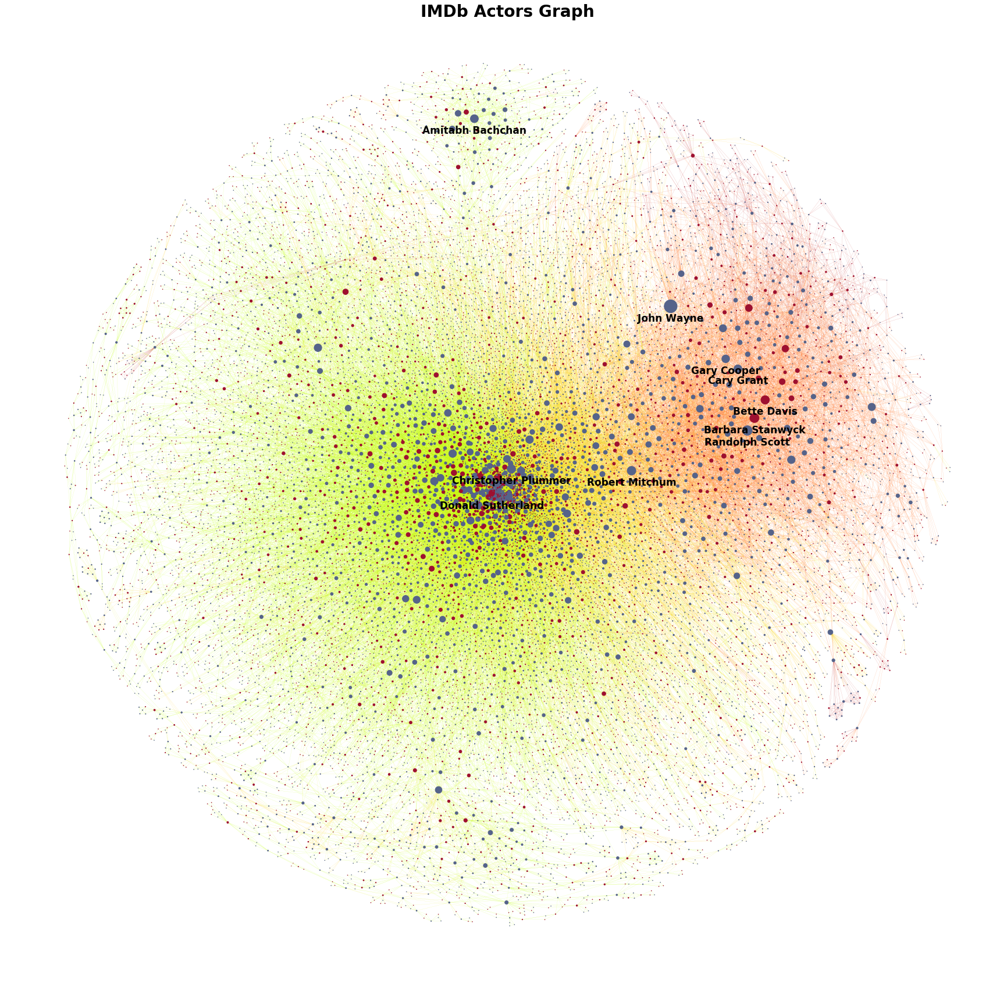

In [14]:
#######
# Draw
#######
#Get colors
colors = getColors(G)
edgesColors = getEdgeColors(G)
#Plot
fig = plt.figure(figsize=(30, 30))
nx.draw_networkx(G, pos, 
                 node_size = [(0.2*sizes[n])**(2) for n in G.nodes()],  
                 node_color = [colors[n] for n in G.nodes()],
                 with_labels=True,
                 width = 0.1,
                 edge_color=[edgesColors[e] for e in G.edges()],
                 labels = labels,
                 font_size = 17, 
                 font_weight= "bold")
plt.axis('off')
plt.title("IMDb Actors Graph", fontdict = title_font )
base = 'Figures/actorGraph'
if savingFigures:
    plt.savefig(base+'.jpeg', bbox_inches='tight')
    plt.savefig(base+'.svg', bbox_inches='tight')
plt.show()

We can distinguish 3 main groups:
* on the right in red, old actors (before 1970)
* on the top, Indian actors
* in the middle, more recent actors

</br>

We can see that, the impact of the collaborations'age. Old American actors are regroup in the same area of the graph. Other old links are harder to visualize. This could be explained by the fact that movie industry was not very big at the time and not very internationnal. Then the links between old non American actors and the bulk of the actors are rare.

## Separate the graph by period

### Basic period statistics

Let's build a function to get a distribution histogram from a list or an array of data.

In [15]:
######################
# HISTOGRAM FUNCTION
######################

def histogram(degrees, dens): # degrees (list or array of data), dens (whether it is a density histogram or not)
    # Computing Bins
    min_bin = np.amin(degrees)
    max_bin = np.amax(degrees)
    nb_bins = int(math.ceil(max_bin)-math.floor(min_bin))
    v = np.empty(nb_bins+1)
    v[nb_bins] = int(math.ceil(max_bin))
    bins = np.empty(nb_bins)
    for i in range(nb_bins):
        v[i] = int(min_bin + i)
        bins[i] = int(min_bin + i)

    #Hist
    hist, bin_edges = np.histogram(degrees,bins = v,density=dens)
    return hist, bin_edges

Let's look how the movies and collaborations a spread across the years

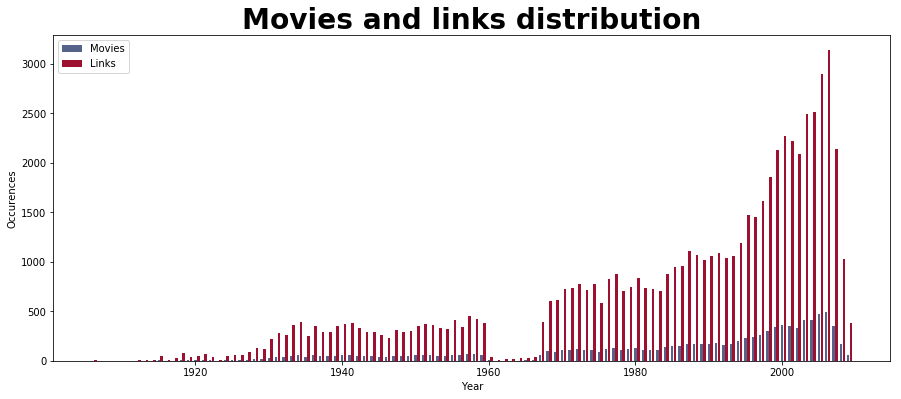

In [16]:
##################################
# HISTOGRAM OF THE MOVIES BY YEAR
##################################

moviesYear = np.asarray(moviesDF["Year"])
linksYear = []
for link in actorsLinks:
    if link[0] != link[1]:
        year = movieAgeDict[link[2]]
        linksYear.append(year)


# Get the histograms
histM, binsM = histogram(moviesYear,False)
histL, binsL = histogram(linksYear,False)

plt.figure(figsize = (15,6))
plt.bar(binsM[:-1], histM, 0.35, color=mBlue, label = "Movies")
plt.bar([b+0.4 for b in binsL[:-1]], histL, 0.35, color=fRed, label = "Links")
plt.xlabel('Year')
plt.ylabel('Occurences')
plt.title('Movies and links distribution', fontdict = title_font)
plt.legend()
base = 'Figures/moviesDist'
if savingFigures:
    plt.savefig(base+'.jpeg', bbox_inches='tight')
    plt.savefig(base+'.png', bbox_inches='tight')
    plt.savefig(base+'.svg', bbox_inches='tight')
plt.show()

The gap in the 1960s corresponds to the worst year for the american industry. Very few movies where produced at this time. Since the 1980s we can see a huge raise in the number of collaborations, but a smaller one for the movies. This could indicate that more and more movies are produced every year since this period, and more and more actors plays in those movies.</br>

So we divide the data into movies from before 1970, then between 1970 and 1980, 1980 and 1990, 1990 and 2000 and finally after 2000

In [17]:
############################
# REPARTITION AMONG PERIODS
############################

#Define periods and set counts
periods = [1900,1970,1980,1990,2000]
moviesByPeriods = np.zeros(5,dtype=int)
linksByPeriods = np.zeros(5,dtype=int)
nMovies = 0
nLinks = 0

#Go through movies
for i in moviesDF.index:
    age = moviesDF.loc[i, "Year"]
    nMovies +=1
    if age < 1970:
        moviesByPeriods[0]+=1
    elif age < 1980:
        moviesByPeriods[1]+=1
    elif age < 1990:
        moviesByPeriods[2]+=1
    elif age < 2000:
        moviesByPeriods[3]+=1
    else:
        moviesByPeriods[4]+=1

#Go through links
for e in G.edges():
    age = G.get_edge_data(*e)["avYear"]
    nLinks +=1
    if age < 1970:
        linksByPeriods[0]+=1
    elif age < 1980:
        linksByPeriods[1]+=1
    elif age < 1990:
        linksByPeriods[2]+=1
    elif age < 2000:
        linksByPeriods[3]+=1
    else:
        linksByPeriods[4]+=1
        
print "Period 1900-1970: "+str(moviesByPeriods[0])+"("+str(round(100*moviesByPeriods[0]/nMovies,2))+"%)"+" movies"+" - "+str(linksByPeriods[0])+"("+str(round(100*linksByPeriods[0]/nLinks,2))+"%)"+" links."
print "Period 1970-1980: "+str(moviesByPeriods[1])+"("+str(round(100*moviesByPeriods[1]/nMovies,2))+"%)"+" movies"+" - "+str(linksByPeriods[1])+"("+str(round(100*linksByPeriods[1]/nLinks,2))+"%)"+" links"
print "Period 1980-1990: "+str(moviesByPeriods[2])+"("+str(round(100*moviesByPeriods[2]/nMovies,2))+"%)"+" movies"+" - "+str(linksByPeriods[2])+"("+str(round(100*linksByPeriods[2]/nLinks,2))+"%)"+" links"
print "Period 1990-2000: "+str(moviesByPeriods[3])+"("+str(round(100*moviesByPeriods[3]/nMovies,2))+"%)"+" movies"+" - "+str(linksByPeriods[3])+"("+str(round(100*linksByPeriods[3]/nLinks,2))+"%)"+" links"
print "Period 2000+:     "+str(moviesByPeriods[4])+"("+str(round(100*moviesByPeriods[4]/nMovies,2))+"%)"+" movies"+" - "+str(linksByPeriods[4])+"("+str(round(100*linksByPeriods[4]/nLinks,2))+"%)"+" links"

Period 1900-1970: 1920(18.96%) movies - 11050(20.96%) links.
Period 1970-1980: 1119(11.05%) movies - 5978(11.34%) links
Period 1980-1990: 1413(13.96%) movies - 7441(14.11%) links
Period 1990-2000: 2251(22.23%) movies - 12120(22.99%) links
Period 2000+:     3421(33.79%) movies - 16138(30.61%) links


### Build Period Graphs

Build a function to get the graph corresponding to a specific period

In [18]:
###################################
# Graph per period function
###################################
def graphPeriod(start,end):
    G_per = nx.Graph()
    #add nodes
    for i in actorsDF.index:
        G_per.add_node(actorsDF.loc[i].at["iD"], Name= actorsDF.loc[i, "Name"], Gender = actorsDF.loc[i, "Gender"])

    #add links
    for link in actorsLinks:
        if (start < movieAgeDict[link[2]]) and (movieAgeDict[link[2]]<= end):
            if link[0]  != link[1]: 
                if G_per.has_edge(link[0],link[1]):                         
                    G_per[link[0]][link[1]]["weight"] +=1 
                    G_per[link[0]][link[1]]["movies"].append(link[2])
                    G_per[link[0]][link[1]]["avRating"] = (G_per[link[0]][link[1]]["avRating"])*(1-1.0/G_per[link[0]][link[1]]["weight"])+ratingDict[link[2]]/G_per[link[0]][link[1]]["weight"]
                    G_per[link[0]][link[1]]["avYear"] = (G_per[link[0]][link[1]]["avYear"])*(1-1.0/G_per[link[0]][link[1]]["weight"])+movieAgeDict[link[2]]/G_per[link[0]][link[1]]["weight"]
                else:
                    G_per.add_edge(link[0], link[1], weight = 1, movies = [link[2]], avRating = ratingDict[link[2]], avYear = movieAgeDict[link[2]]) 

    #take the giant component
    G_per=max(nx.connected_component_subgraphs(G_per), key=len)
    print "There are "+str(G_per.number_of_nodes()) +" nodes(actors) and "+ str(G_per.number_of_edges())+ " links(movie collaboration) in "+str(start)+'-'+str(end)+" period."
    return G_per

In [19]:
###################################
# Subdivide the network by period
###################################

graphByPeriod = {}
for i in range(len(periods)):
    if i <4:
        gph = graphPeriod(periods[i],periods[i+1])
        if savingData:
            nx.write_gpickle(G, 'obj/graph_'+str(periods[i+1])+'.gpickle') 
        graphByPeriod[str(periods[i+1])]=gph
    else:
        gph = graphPeriod(periods[i],2020)
        graphByPeriod["now"]=gph
        if savingData:
            nx.write_gpickle(G, 'obj/graph_now.gpickle') 

# Graph Titles
titles = {}
titles["1970"] = "1900-1970"
titles["1980"] = "1970-1980"
titles["1990"] = "1980-1990"
titles["2000"] = "1990-2000"
titles["now"] = "2000+"

There are 3175 nodes(actors) and 10999 links(movie collaboration) in 1900-1970 period.
There are 2072 nodes(actors) and 5123 links(movie collaboration) in 1970-1980 period.
There are 2569 nodes(actors) and 6171 links(movie collaboration) in 1980-1990 period.
There are 4302 nodes(actors) and 11573 links(movie collaboration) in 1990-2000 period.
There are 5049 nodes(actors) and 12859 links(movie collaboration) in 2000-2020 period.


We store the graph and the corresponding data in dictionaries which makes it easy to access after.

### Visualization

Same as before for the full graph, there two options either directly with the force atlas algorithm or with the short-cut files.

In [20]:
################################
# Graph per period positionning
################################
positionsPeriod = {}

if not fastExecution:
    for key in graphByPeriod:
        p = forceatlas2.forceatlas2_networkx_layout(graphByPeriod[key], pos=None, iterations=3000)
        positionsPeriod[key] = p
        if savingData:
            #Build a shortcut to speed up and not re-run the algorithm
            #Store the positions in a text file
            path = "DATA/forceAtlasPositions_"+key+".txt"
            files = io.open(path, mode="w", encoding="utf-8")
            for key in p.keys():
                row = key +"\t" + str(p[key][0]) +"\t"+str(p[key][1])+"\r\n"
                files.write(row.replace("u'","").replace("'",""))
            files.close()
else:    
    #Get the Dictionnary
    for key in graphByPeriod:
        posit={}
        path = "DATA/forceAtlasPositions_"+key+".txt"
        files = io.open(path, mode="r", encoding="utf-8")
        for row in files:
            split = row.split("\t")
            posit[split[0]] = (float(split[1]),float(split[2]))
        files.close()
        positionsPeriod[key] = posit

We build a draw function to automatize the drawing of the period graphs. In input it receive the considered graph, the title of the representation build and the positions of the nodes given by the force atlas algorithm.
</br> 
Sizes are computed the same way as for the full graph before.

In [21]:
################
# DRAW FUNCTION
################

#Auxiliary function
def getSecond(a):
    return a[1]

def draw(graph,ttl,posi):
    colors = getColors(graph)  # Build the color and size arrays

    #SIZE
    # Get the actor/actress with the biggest number of collaborations
    sizes = {}
    os = []
    sizeMax =0
    for iD in graph.nodes():
        edges = list(graph.edges(iD))
        ogStrength = 0
        for e in edges:
            ogStrength += graph.get_edge_data(*e)["weight"] 
        sizes[iD] = ogStrength
        os.append((graph.nodes[iD]["Name"],ogStrength))
        if ogStrength > sizeMax:
            sizeMax = ogStrength

    #LABEL
    # Build a label dictionnary with the name of the members to highlight
    SortedNames = np.asarray(sorted(os, key=getSecond,reverse = True))[:,0]
    SortedNames = SortedNames[:10]
    labels = {}
    for n in graph.nodes():
        name = actorNameDict[n]
        if name in SortedNames:
            labels[n]="\n\n"+name
        else:
            labels[n]=""

    #POSITIONNING
    positions = posi

    alpha =25/sizeMax
    fig = plt.figure(figsize=(30, 30))
    nx.draw_networkx(graph, positions, 
                     node_size = [(alpha*sizes[n])**(2) for n in graph.nodes()],  node_color = [colors[n] for n in graph.nodes()],
                     with_labels=True,
                     width = 0.1,edge_color='#999999',labels = labels,font_size = 17, font_weight= "bold")
    plt.axis('off')
    plt.title("Actors Graph Period "+ttl, fontdict = title_font  )
    base = 'Figures/actorGraph_'+ttl
    if savingFigures:
        plt.savefig(base+'.jpeg', bbox_inches='tight')
        plt.savefig(base+'.png', bbox_inches='tight')
        plt.savefig(base+'.svg', bbox_inches='tight')
    plt.show()

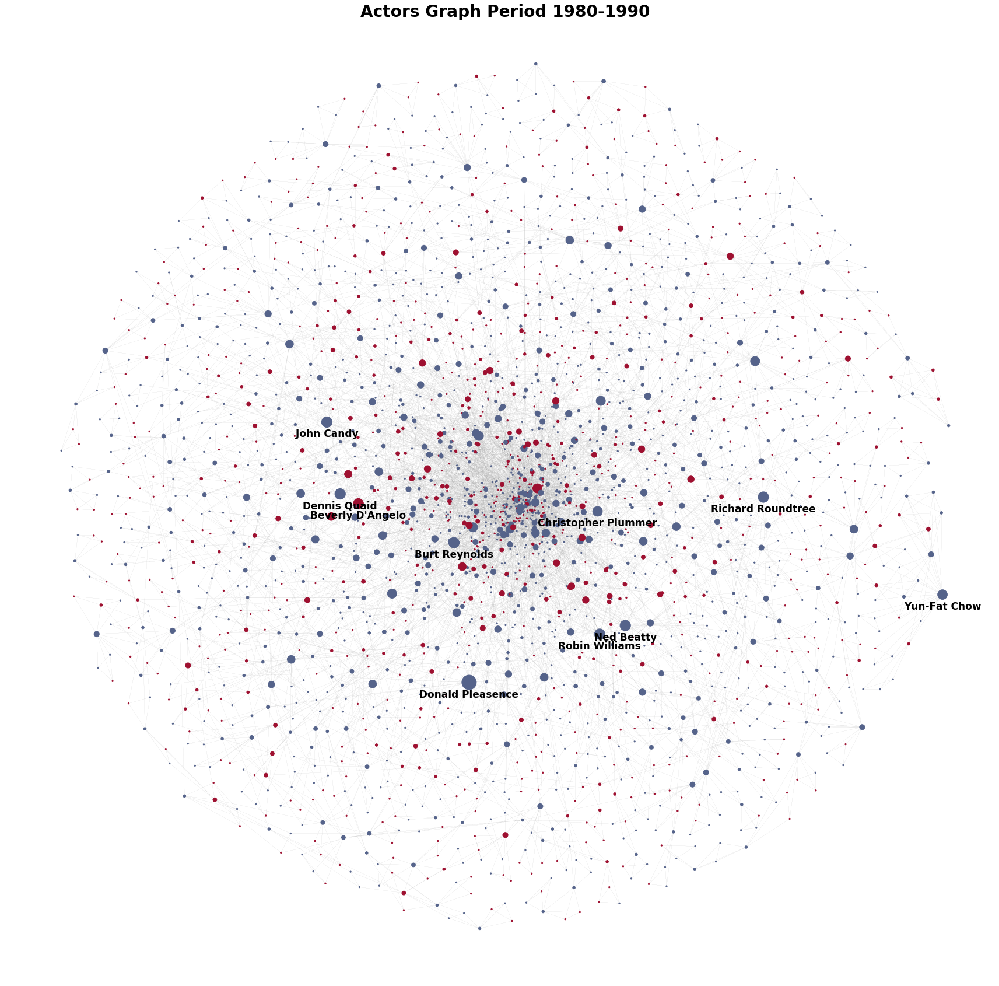

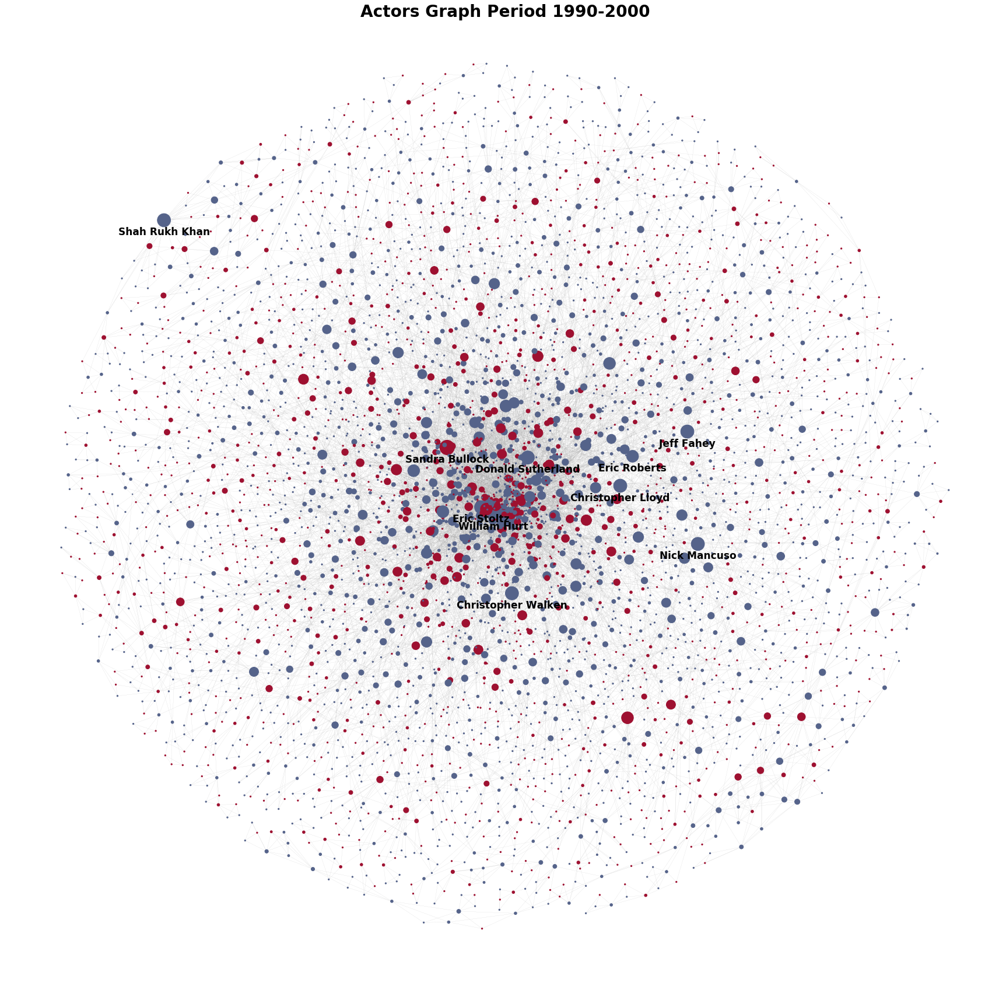

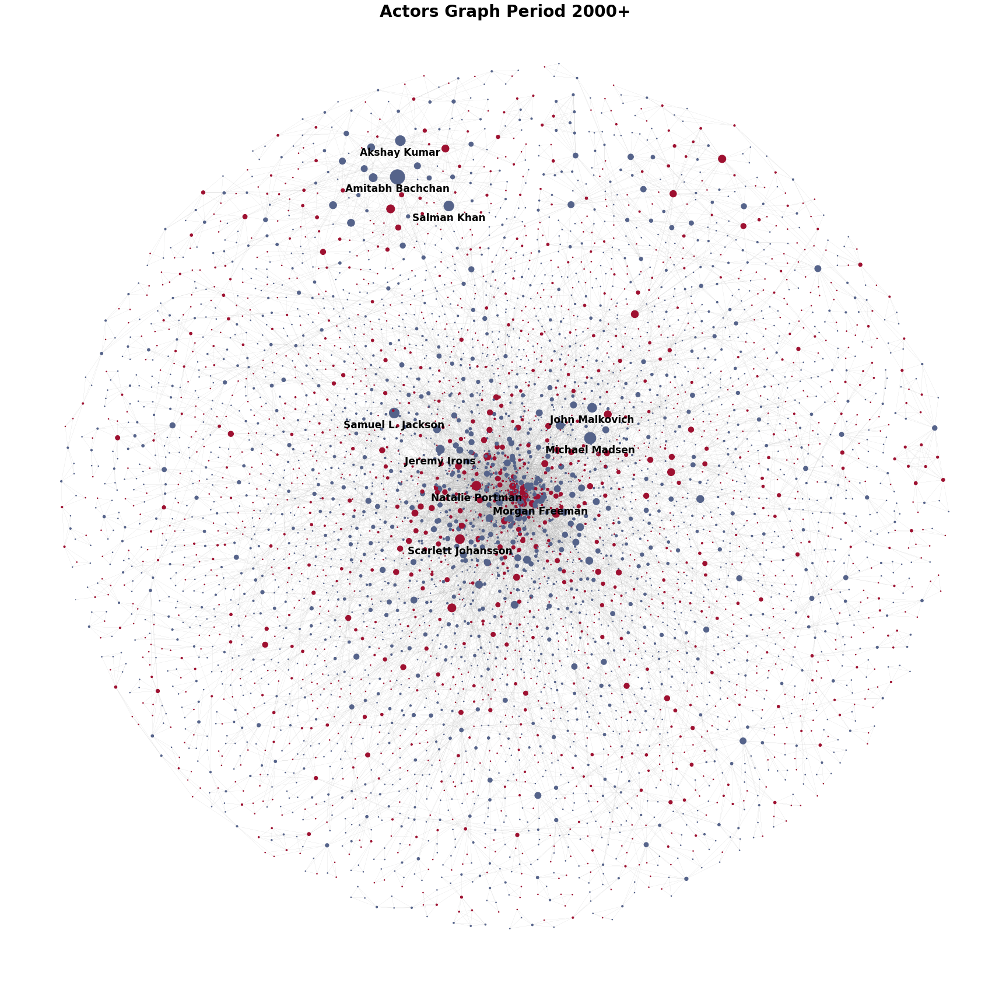

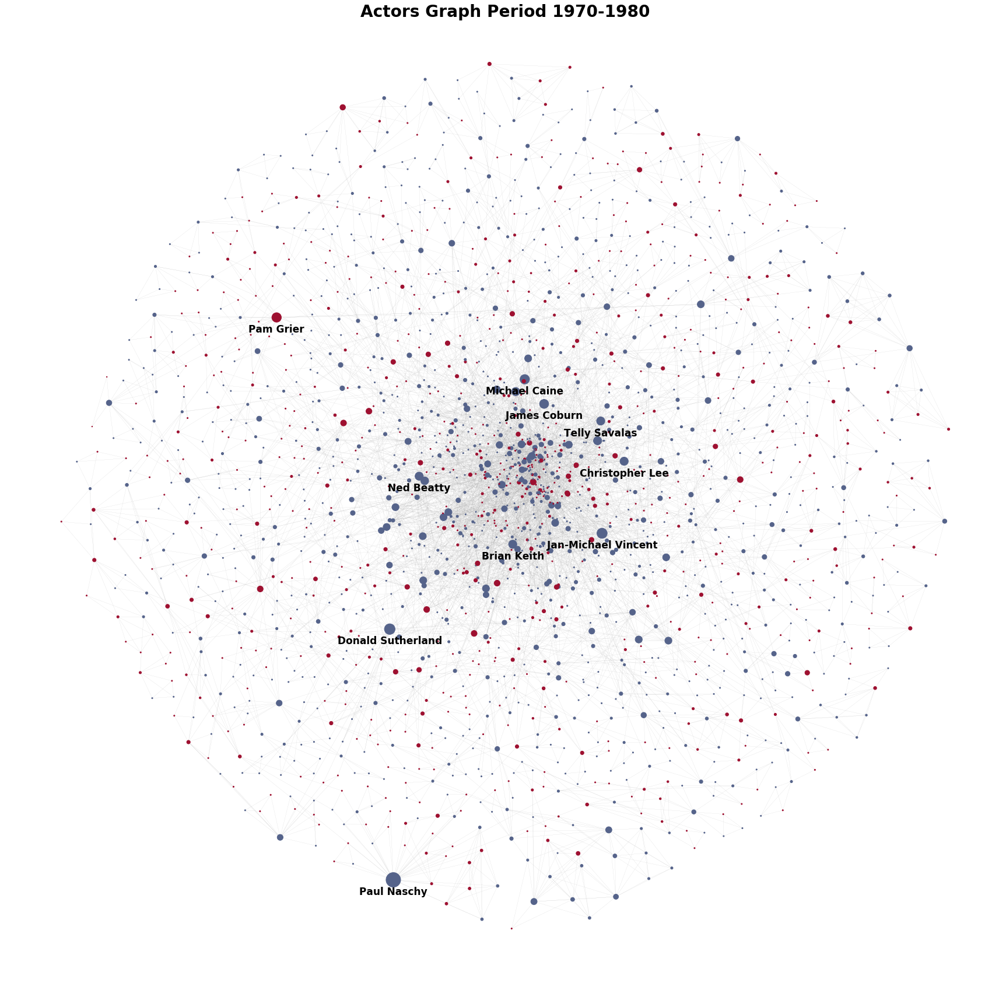

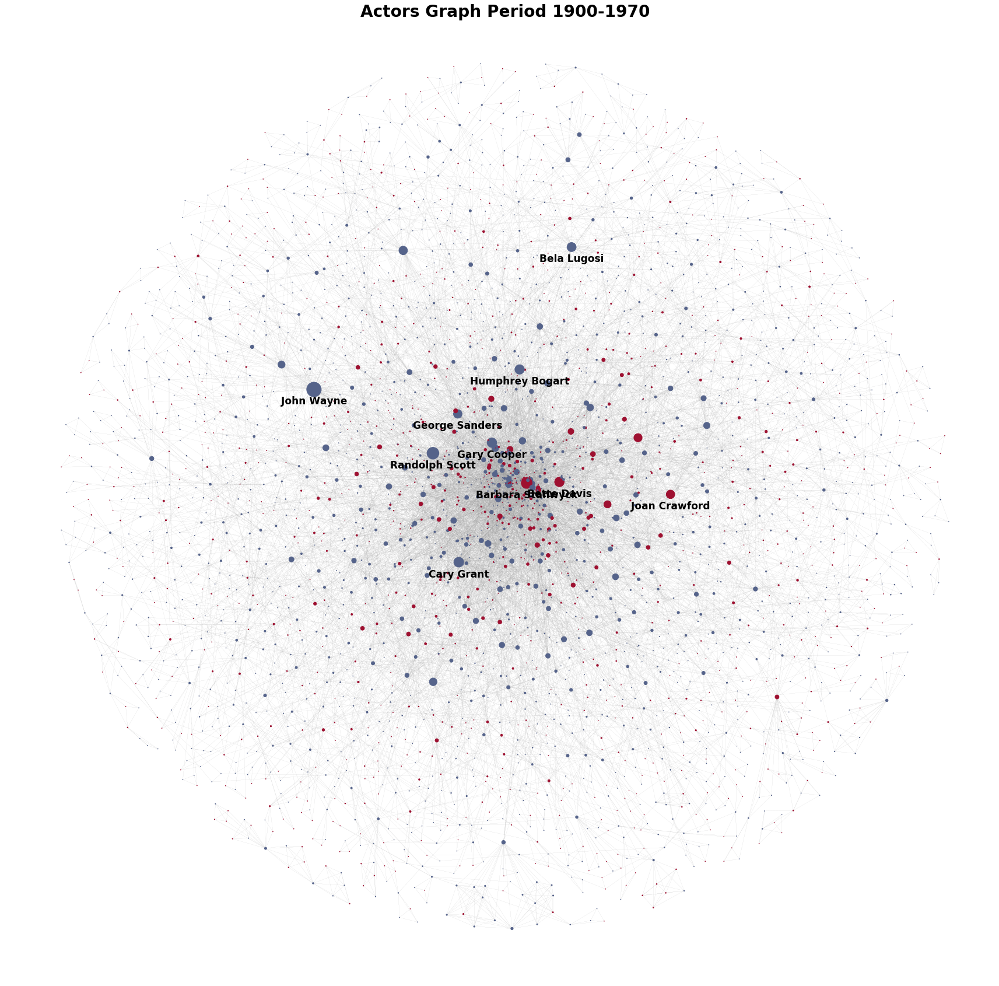

In [22]:
####################
# Draw the networks
####################

for key in graphByPeriod.keys():
    draw(graphByPeriod[key],titles[key], positionsPeriod[key])

In general in the center of the graph, we find american actors because it is the major industry, and on the outside, actors from smaller industries (internatinnaly speaking) can emerge: Indians in the 2000+ graph for example.

## Statistics

### Degree Analysis

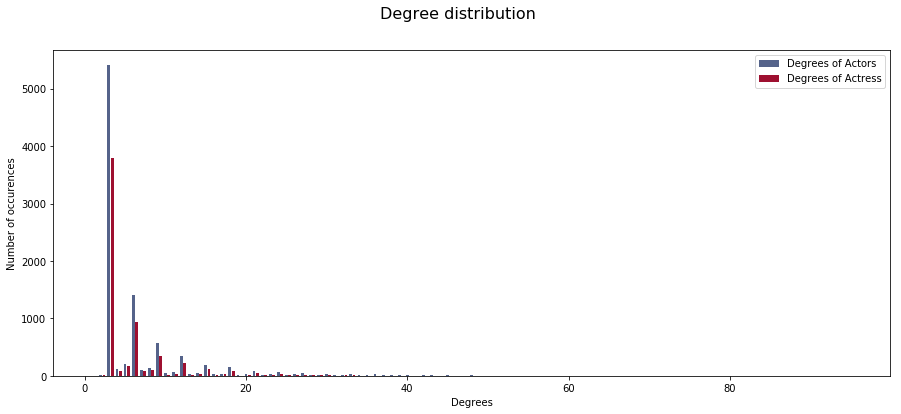

In [23]:
################################
# Display the degrees histogram 
################################

# Get the degrees
mDegrees = [G.degree(n) for n in G.nodes() if G.nodes[n]["Gender"] == "M"]
fDegrees = [G.degree(n) for n in G.nodes() if G.nodes[n]["Gender"] == "F"]
degrees = [G.degree(n) for n in G.nodes()]

# Get the histograms
histM, binsM = histogram(mDegrees,False)
histF, binsF = histogram(fDegrees,False)
histD, binsD = histogram(degrees,True)

# Plot
plt.figure(figsize = (15,6))
plt.bar(binsM[:-1], histM, 0.35, color=mBlue, label = "Degrees of Actors")
plt.bar([b+0.4 for b in binsF[:-1]], histF, 0.35, color=fRed, label = "Degrees of Actress")
plt.xlabel('Degrees')
plt.ylabel('Number of occurences')
plt.suptitle('Degree distribution', fontsize=16)
plt.legend()
base = 'Figures/degreeDist'
if savingFigures:
    plt.savefig(base+'.jpeg', bbox_inches='tight')
    plt.savefig(base+'.png', bbox_inches='tight')
    plt.savefig(base+'.svg', bbox_inches='tight')
plt.show()

There are less actress than actors but the distribution of their degrees are really similar.

Let's compare the degree distributions with random networks ones (Poisson) and scale free ones.

In [24]:
#######################
# Degree distributions 
#######################

def PoissDegree(ks,avg):
    return [np.exp(-avg)*avg**k/math.factorial(int(k)) for k in ks]
def ScaleFreeDegree(ks,gamma):
    return [k**(-gamma)/zeta(gamma) for k in ks]

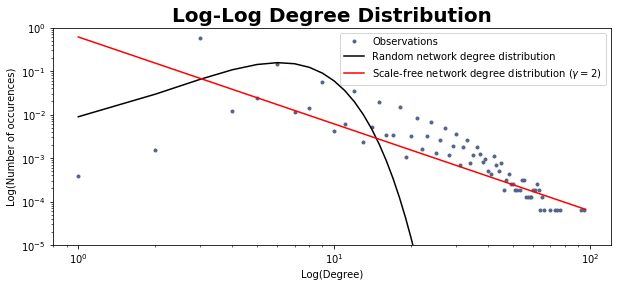

In [25]:
################################################
# Degree distributions ploting on log log scale
################################################

# Log-Log Plot zoom on scale free
plt.figure(figsize = (10,4))
title_font['size'] = 20
plt.title("Log-Log Degree Distribution", fontdict = title_font)
plt.loglog(binsD[:-1], histD, '.', color=mBlue)
plt.xlabel('Log(Degree)')
plt.ylabel('Log(Number of occurences)')
plt.ylim(1e-5,1)
avg = np.mean(degrees)
ks = np.linspace(1,np.max(degrees),np.max(degrees))
plt.loglog(ks,PoissDegree(ks,avg),"-",color="k")
plt.loglog(ks,ScaleFreeDegree(ks,2),"-",color="r")
plt.legend(["Observations",
            "Random network degree distribution",
            "Scale-free network degree distribution ($\gamma = 2$)"])
base = 'Figures/loglogZoomDegreeDist'
if savingFigures:
    plt.savefig(base+'.jpeg', bbox_inches='tight')
    plt.savefig(base+'.png', bbox_inches='tight')
    plt.savefig(base+'.svg', bbox_inches='tight')
plt.show()

Let's package the degree analysis in a function to run it over all the period graphs.

In [26]:
#######################
# Full Degree Analysis
#######################

def degreeAnalysis(graph,ttl):
    # Get the degrees
    degrees = [graph.degree(n) for n in graph.nodes()]

    # Get the histograms
    histD, binsD = histogram(degrees,True)

    # Log-Log Plot zoom on scale free
    plt.figure(figsize = (10,4))
    plt.title("Log-Log Degree Distribution of period "+ttl)
    plt.loglog(binsD[:-1], histD, '.', color=mBlue)
    plt.xlabel('Log(Degree)')
    plt.ylabel('Log(Number of occurences)')
    plt.ylim(1e-5,1)
    avg = np.mean(degrees)
    ks = np.linspace(1,np.max(degrees),np.max(degrees))
    plt.loglog(ks,PoissDegree(ks,avg),"-",color="k")
    plt.loglog(ks,ScaleFreeDegree(ks,2),"-",color="r")
    plt.legend(["Observations",
                "Random network degree distribution",
                "Scale-free network degree distribution ($\gamma = 2$)"])
    base = 'Figures/loglogZoomDegreeDist_'+ttl
    if savingFigures:
        plt.savefig(base+'.jpeg', bbox_inches='tight')
        plt.savefig(base+'.png', bbox_inches='tight')
        plt.savefig(base+'.svg', bbox_inches='tight')
    plt.show()

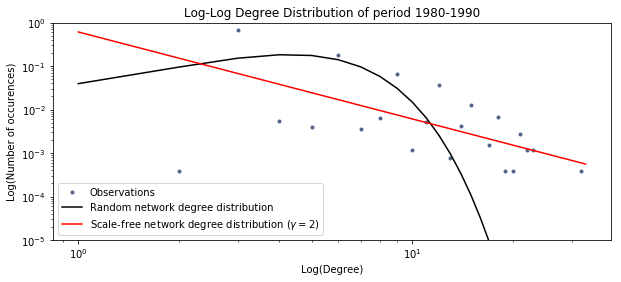

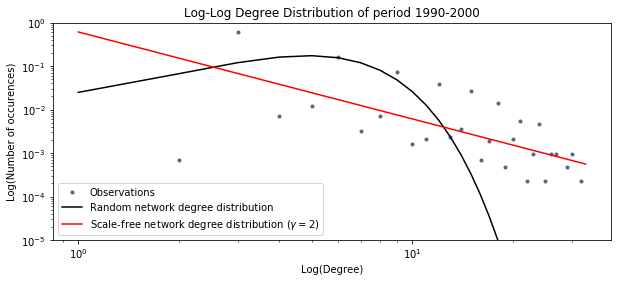

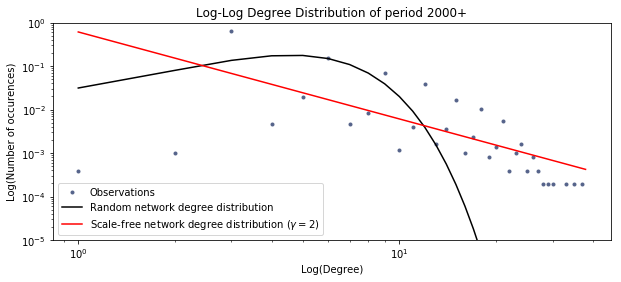

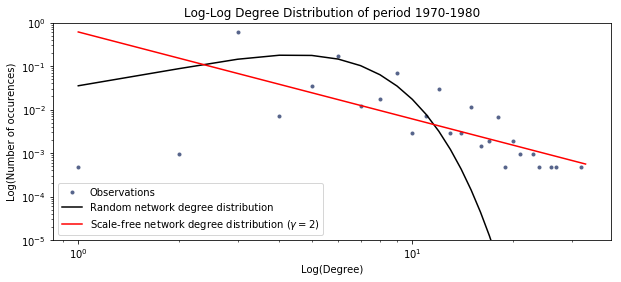

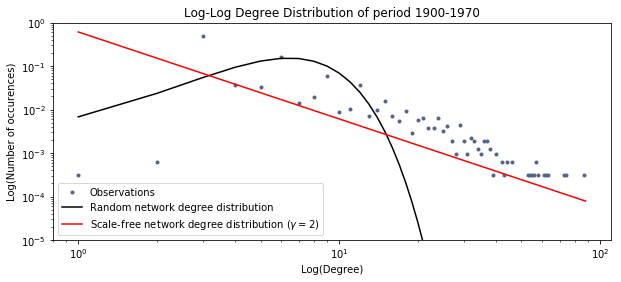

In [27]:
##########################
# Run the Degree Analysis
##########################

for key in graphByPeriod.keys():
    degreeAnalysis(graphByPeriod[key],titles[key])

All the distribution shows that the small degree nodes behave like random networks whereas the large ones tends to act like scale-free networks. This illustrate the fact that Random Network under estimate the likeliness of nodes with very large degrees to exist. In this case, those nodes corresponds to actors playing in a high number of movies with, then, a high number of partners.

## Community Detection

To seperate the graph, we want to run a communtity detection algorithm. For the community detection we used the Louvain algorithm due to the high modularity found by the algorithm [Orman, 2011].

In [28]:
##############################
# COMPUTE COMMUNITY DETECTION
##############################

def communityDetect(graph):
    # We used the Louvain algorithm
    partition = community.best_partition(graph)

    # Compute the modularity
    modularity = community.modularity(partition,graph)
    s = "The partition made of the graph has a modularity of +"+str(round(modularity*100,3))
    s +="% and contains "+str(len(set(partition.values())))+" communities."
    print s
    
    return partition,modularity

Let's use a function to draw the communities. This function also return the id of the biggest communities to study them afterwards.

In [29]:
#######################
# PLOT THE COMMUNITIES
#######################

# Define a color range to differentiate the communities
colorRange = np.asarray([mBlue,'#db3aAA',fRed,'#aac857','#32BBAA','#4020AA','#084c61','#407058','#177e89','#bbcdcd'])

##INPUT : 
# graph to draw, corresponding communities, title to give, 
# positions of the nodes, boolean (whether it is the full graph or not)

##OUTPUT :
# id of the communities big enough to be displayed
def drawCommunities(graph, partition, ttl, posi, full): 
    # Drawing
    minComm = graph.number_of_nodes()/60 #biggest community limit
    biggestCommunitiesLabel={}
    fig = plt.figure(figsize=(15, 15))
    nextColor =0            # Color count to go through the color range
    for com in set(partition.values()) :
        list_nodes = [nodes for nodes in partition.keys()            # Go throught the communities built
                                    if partition[nodes] == com]
        if len(list_nodes)>minComm: # Pick a color for the big communities 
            col = nextColor % 10
            color = colorRange[col]
            nextColor +=1
            shape = "o"
            if nextColor>9:
                shape = "^"
            if nextColor>19:
                shape = "s"
            alph =1
            labl = "Community "+str(com)+": "+str(len(list_nodes))+" members"
            biggestCommunitiesLabel[com]=labl
            nx.draw_networkx_nodes(graph, posi, list_nodes, node_size = 30,node_color = color, alpha=alph,node_shape=shape, label = labl)
        else: # Small communities are drawn in grey to increase readablility
            color = "#BBBBBB"
            alph = 0.2
            nx.draw_networkx_nodes(graph, posi, list_nodes, node_size = 20,node_color = color, alpha=alph)  


    nx.draw_networkx_edges(graph, posi,  width = 0.1, arrows=False, alpha=0.5) # Draw the edges
    plt.axis('off')
    plt.legend()
    if full:
        plt.title('Actor Graph Communities', fontdict = title_font)
        base = 'Figures/communities'
    else:   
        plt.title('Communities for the period '+ttl, fontdict = title_font)
        base = 'Figures/communities_'+ttl
    if not savingFigures:
        plt.savefig(base+'.jpeg', bbox_inches='tight')
        plt.savefig(base+'.png', bbox_inches='tight')
        plt.savefig(base+'.svg', bbox_inches='tight')
    plt.show()
    return biggestCommunitiesLabel

The partition made of the graph has a modularity of +69.646% and contains 121 communities.


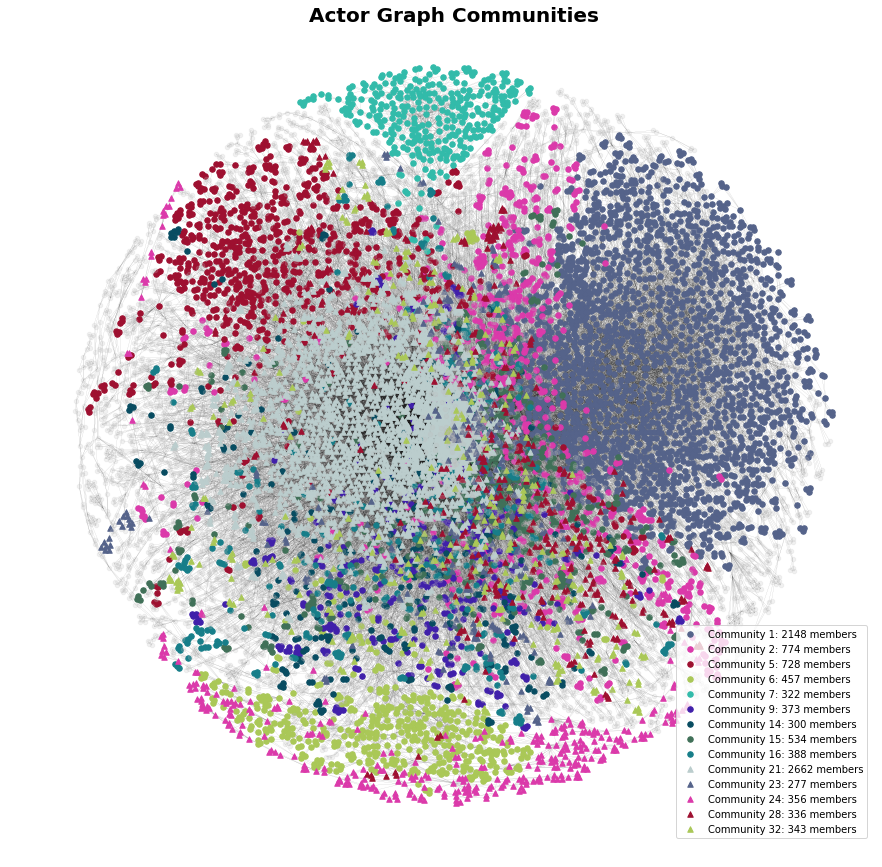

In [30]:
#############################################
# RUN COMMUNITY DETECTION FOR THE FULL GRAPH
#############################################

partG,modulG = communityDetect(G)
biggestCommunitiesLabel = drawCommunities(G,partG,"full",pos, True)

The partition made of the graph has a modularity of +79.605% and contains 40 communities.


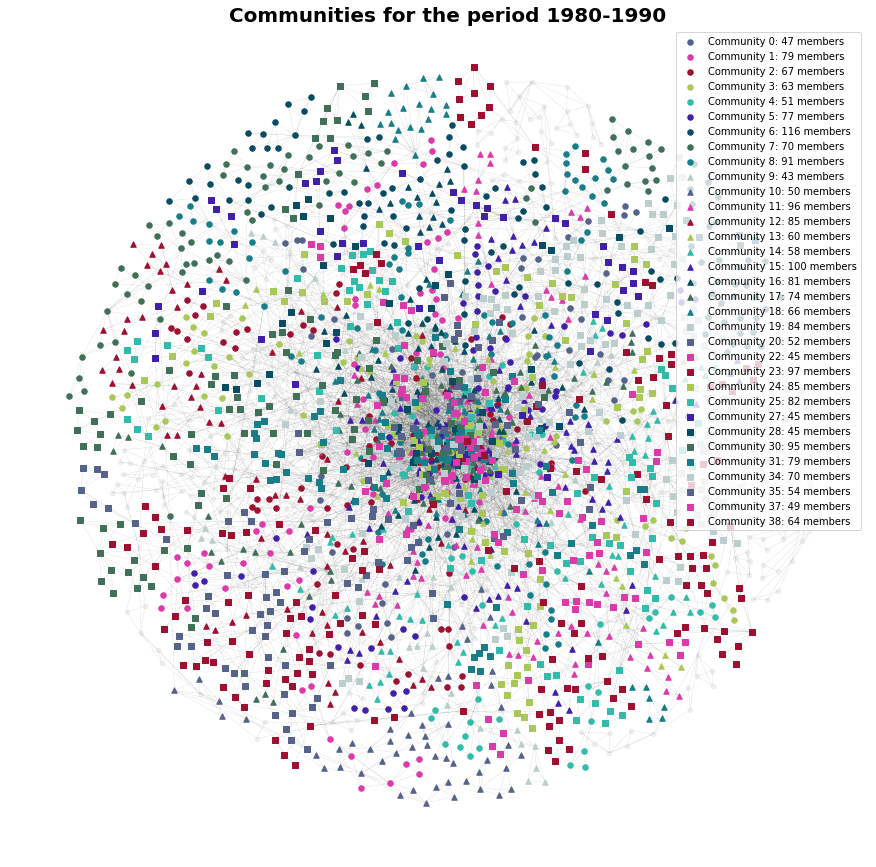

The partition made of the graph has a modularity of +72.305% and contains 46 communities.


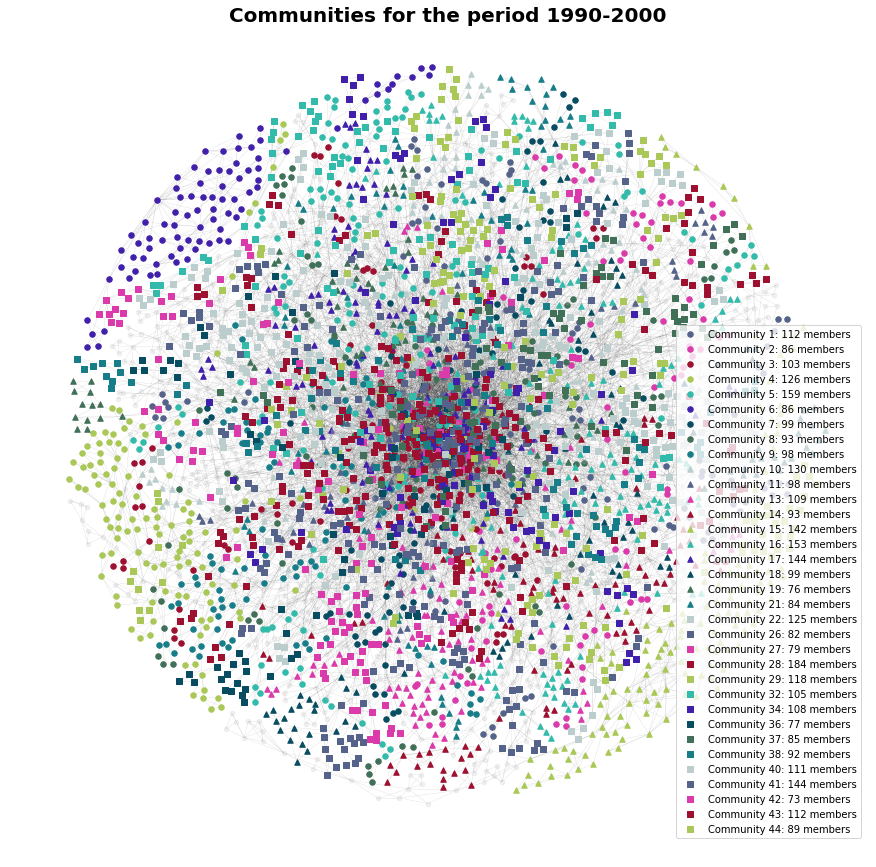

The partition made of the graph has a modularity of +79.004% and contains 50 communities.


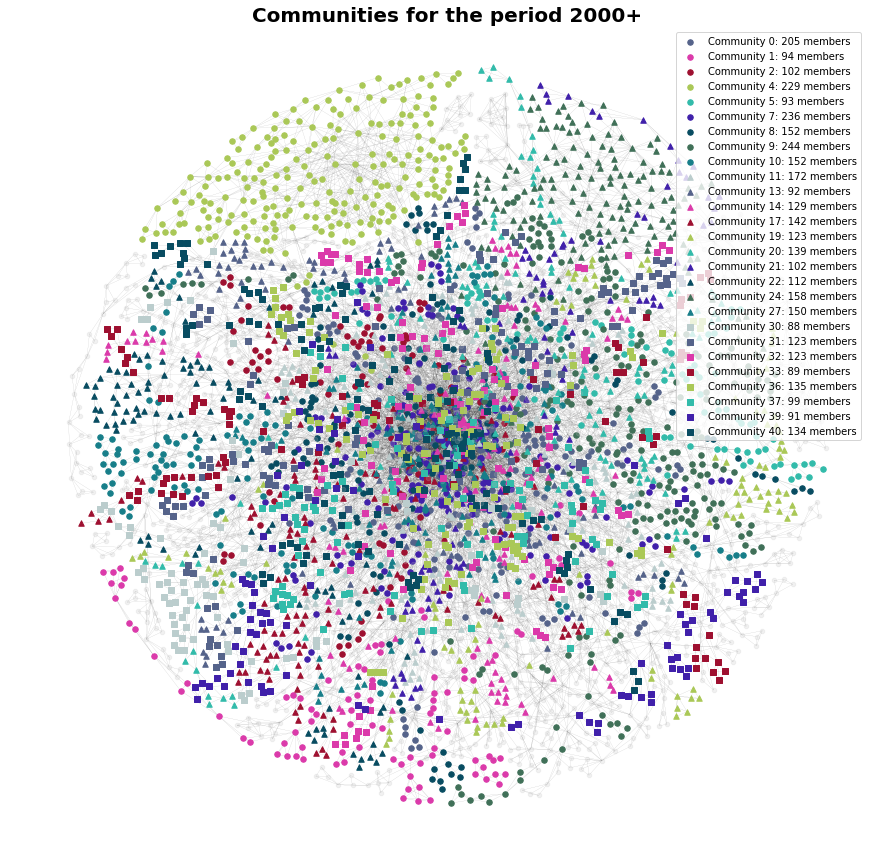

The partition made of the graph has a modularity of +80.372% and contains 38 communities.


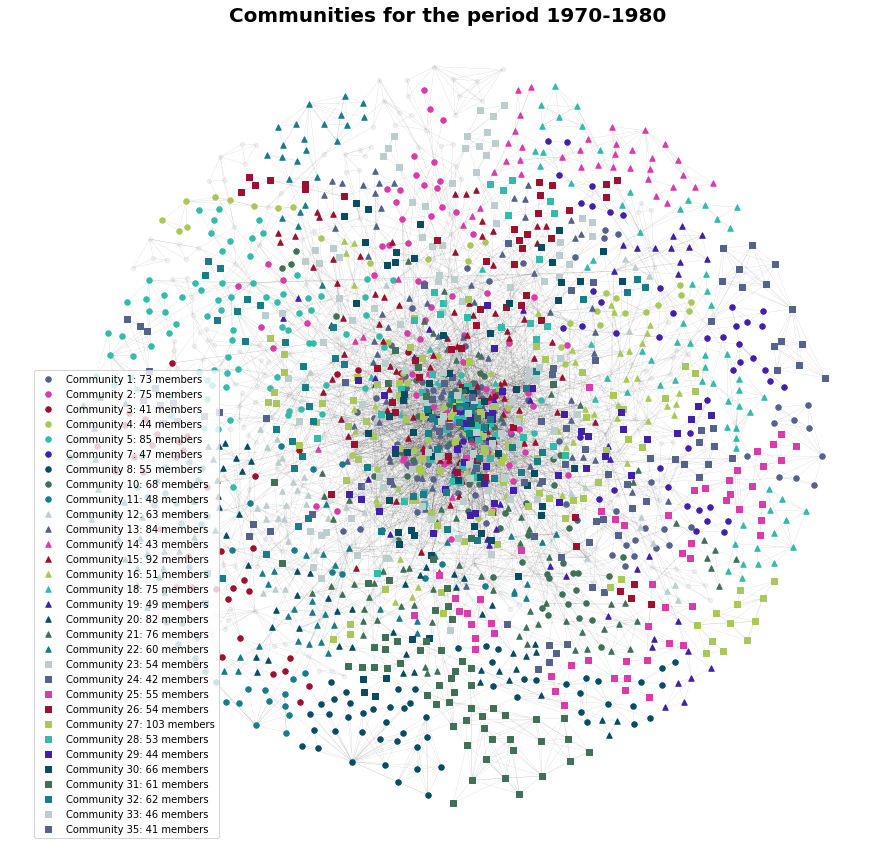

The partition made of the graph has a modularity of +61.058% and contains 32 communities.


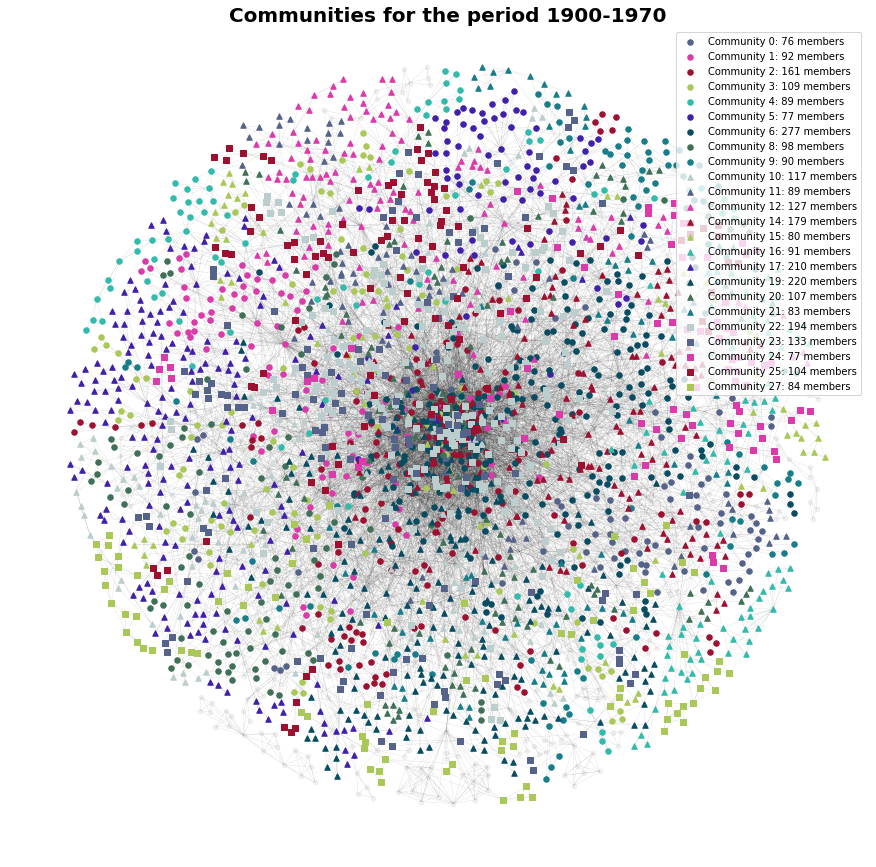

In [31]:
###############################################
# RUN COMMUNITY DETECTION FOR THE PERIOD GRAPH
###############################################

# Initiate diacts to store data
partDict = {}
modulDict = {}
biggestCommDict = {}

# Run the community detection
for key in graphByPeriod.keys():
    p,m = communityDetect(graphByPeriod[key])
    b = drawCommunities(graphByPeriod[key],p,titles[key], positionsPeriod[key],False)
    partDict[key]=p
    modulDict[key]=m
    biggestCommDict[key]=b

The communities seem very clear in the full graph, for each period some communities seems clear but they are more mixed in the graphs.</br>

To have a better understanding of those communities, let's analyse which actors and movies they are composed with. We gonna study:
* The age of the movies
* The actors (nationality)
* The movies (type)
* The ratings
* The sentiments score from the sentiment analysis </br>

To study the sentiments we first gonna store [sentiment analysis results](http://nbviewer.jupyter.org/github/s134265/socialgraphs2018/blob/master/Project/Sentiment%20Analysis.ipynb) in to a dictionary.


In [32]:
#####################
# GET THE SENTIMENTS
#####################
files = open("sentiment.txt")
s = files.readlines()[0]
sentimentDict = json.loads(s)

Let's build a function to analyse the communities. For a graph, a partition and a list of the communities, it build a report containing for all the large communities, the main actors and movies, basic statistics on age, rating and sentiments.

In [33]:
##########################
# COMMUNITIES EXPLANATION
##########################
def communityExplain(graph, partition, bigComms, classification, lim):
    commString = "" # String containing all the infos collected
    for com in bigComms.keys(): # Go throught the large communities for this graph
        list_nodes = [nodes for nodes in partition.keys() if partition[nodes] == com] #collect the nodes of this com
        grphCom = graph.subgraph(list_nodes) #Select the subgraph corresponding to the community
        os = []  #Store the outgoing strenght to get the main actors
        rating = [] #Store the ratings
        age = [] #Store the age of the movies
        movies = {} #Store the movies
        for iD in grphCom.nodes(): # Go throught the nodes
            edges = list(grphCom.edges(iD))
            lMovies = []
            ogStrength = 0
            for e in edges: # Store the data get from every edges of the sub graph
                ogStrength += grphCom.get_edge_data(*e)["weight"]
                rating.append(grphCom.get_edge_data(*e)["avRating"])
                age.append(grphCom.get_edge_data(*e)["avYear"])
                m = grphCom.get_edge_data(*e)["movies"]
                for i in m:
                    lMovies.append(i)
                    if i in movies.keys():
                        movies[i]+=1
                    else:
                        movies[i]=1
            if not classification == "collaborations":
                ogStrength = ogStrength/len(edges)
            if len(set(lMovies))>lim:
                os.append((graph.nodes[iD]["Name"],ogStrength))
            
        # Start the txt log
        commString += "\r\n \r\n####################################### \r\n"
        commString += "Community: "+str(com) + "\r\n"
        commString += "####################################### \r\n \r\n"
        commString += "Members:"+str(len(list_nodes))+ "\r\n"
        # Get and log the main actors
        mainAc = sorted(os, key=getSecond, reverse = True)
        s = "Main Actors: "
        nActorsToPrint = 5
        if len(mainAc) <5:
            nActorsToPrint=len(mainAc)
        for i in range(nActorsToPrint):
            s+= mainAc[i][0]+" ("+str(mainAc[i][1])+" "+classification+") "
        # Log the year and ratings
        commString += s + "\r\n"
        commString += "Year: "+str(round(np.min(age)))+'-'+str(round(np.max(age)))+"  Av: "+str(round(np.mean(age),2))+"  Std: "+str(round(np.std(age),2)) + "\r\n"
        commString +="Ratings: "+str(round(np.min(rating),2))+'-'+str(round(np.max(rating),2))+"  Av: "+str(round(np.mean(rating),2))+"  Std: "+str(round(np.std(rating),2)) + "\r\n"
        mainMovies = sorted(movies.items(), key= getSecond, reverse = True)
        # Get and log the main movies
        s = "Main Movies: "
        for i in range(5):
            if mainMovies[i][0] in movieNameDict.keys():
                s+= movieNameDict[mainMovies[i][0]]+" ("+str(mainMovies[i][1]/2)+" times) "
        commString += s + "\r\n"
        # Get and log the sentiment
        sentiment = []
        for i in range(len(mainMovies)):
            if mainMovies[i][0] in sentimentDict.keys():
                sentiment.append((sentimentDict[mainMovies[i][0]][1]*1.0/sentimentDict[mainMovies[i][0]][0]))
        s = "Sentiments: "+str(round(np.min(sentiment),5))+'-'+str(round(np.max(sentiment),5))+"  Av: "+str(round(np.mean(sentiment),5))+"  Std: "+str(round(np.std(sentiment),5)) + "\r\n"
        commString += s + "\r\n"
    
    # return the log built
    return commString

In [34]:
#########################
# ANALYSE THE FULL GRAPH
#########################
files = io.open("Full_communityAnalysis.txt", mode="w", encoding="utf-8" )
s = communityExplain(G,partG,biggestCommunitiesLabel,"collaborations",1)
print s
files.write(s)
files.close()


 
####################################### 
Community: 32
####################################### 
 
Members:343
Main Actors: James Brolin (18 collaborations) Michael Lonsdale (11 collaborations) Matt McCoy (11 collaborations) Connie Sellecca (11 collaborations) Alana Austin (10 collaborations) 
Year: 1950.0-2008.0  Av: 1994.36  Std: 11.95
Ratings: 2.6-8.5  Av: 5.6  Std: 1.17
Main Movies: La mujer del aviador (15.0 times) India Song (15.0 times) The Gig (6.0 times) Eréndira (6.0 times) Saam gaang yi (6.0 times) 
Sentiments: 5.1389-6.05477  Av: 5.66506  Std: 0.1524


 
####################################### 
Community: 1
####################################### 
 
Members:2148
Main Actors: John Wayne (96 collaborations) Randolph Scott (83 collaborations) Barbara Stanwyck (78 collaborations) Cary Grant (68 collaborations) Bette Davis (68 collaborations) 
Year: 1917.0-2005.0  Av: 1946.24  Std: 12.71
Ratings: 1.8-8.9  Av: 6.4  Std: 0.93
Main Movies: Glen or Glenda (21.0 times) The Star Pac

* Community 1 correponds mainly to old movies (1946 in average with a standard deviation of 12.71), mostly american.
* Community 2: A second generation of movies (1975 in average), british and american mainly
* Community 5: French actors and movies
* Community 6: Chinese
* Community 7: Indian
* Community 16: Have a lower rating than the other communities (Av: 4.96  Std: 1.19)
* Community 21: The most recent american(anglo-saxon) movies (Av: 1997.42  Std: 8.42)
* Community 24: Japanese

The sentiment tends to be really close across the communities, but the ratings differ through the communities, old movies(6.4), french movies(6.62), indian movies(6.43) and japanese one(6.53) have better rating in average.

In [35]:
########################
# ANALYSE PERIOD GRAPHS
########################
files = io.open("communityAnalysis.txt", mode="w", encoding="utf-8" )
for key in graphByPeriod.keys(): #Go through all period graph
    p = partDict[key]
    m = modulDict[key]
    b = biggestCommDict[key]
    
    #Print the report
    s1 = "\r\n#######################################  \r\n####################################### \r\n\r\n"
    s1 += "Period: "+titles[key]+ "\r\n" + "Modularity: "+str(m)+ "\r\n \r\n" +"#######################################  \r\n####################################### \r\n"
    print "#######################################"
    print "#######################################"
    print ""
    print "Period: "+titles[key]
    print "Modularity: "+str(m)
    print ""
    print "#######################################"
    print "#######################################"
    files.write(unicode(s1, "utf-8"))
    s = communityExplain(graphByPeriod[key],p,b, "collaborations",7)
    files.write(s)
    print s
files.close()

#######################################
#######################################

Period: 1980-1990
Modularity: 0.796045430548

#######################################
#######################################

 
####################################### 
Community: 0
####################################### 
 
Members:47
Main Actors: 
Year: 1982.0-1990.0  Av: 1986.38  Std: 2.68
Ratings: 4.3-7.4  Av: 5.78  Std: 0.87
Main Movies: Hanky Panky (6.0 times) The Well (6.0 times) Who Dares Wins (6.0 times) Absolute Beginners (6.0 times) Trapped (6.0 times) 
Sentiments: 5.3818-5.93921  Av: 5.69283  Std: 0.13961


 
####################################### 
Community: 1
####################################### 
 
Members:79
Main Actors: 
Year: 1981.0-1990.0  Av: 1985.44  Std: 3.06
Ratings: 4.1-7.7  Av: 5.86  Std: 0.9
Main Movies: The Wrong Guys (6.0 times) Dead Men Don't Die (6.0 times) One Dark Night (6.0 times) Jane and the Lost City (6.0 times) Robocop 2 (6.0 times) 
Sentiments: 5.28397-5.88022  Av:


 
####################################### 
Community: 1
####################################### 
 
Members:112
Main Actors: 
Year: 1991.0-2000.0  Av: 1996.47  Std: 2.71
Ratings: 2.9-7.9  Av: 5.45  Std: 1.34
Main Movies: Bajo la arena (6.0 times) Delivered (6.0 times) Hidden Passion (6.0 times) Washington Square (6.0 times) Children of the Corn II: The Final Sacrifice (6.0 times) 
Sentiments: 5.18651-6.02011  Av: 5.65849  Std: 0.15885


 
####################################### 
Community: 2
####################################### 
 
Members:86
Main Actors: 
Year: 1991.0-2000.0  Av: 1995.91  Std: 2.72
Ratings: 2.6-7.7  Av: 5.09  Std: 1.34
Main Movies: G2 (15.0 times) Man of the House (6.0 times) Fear of a Black Hat (6.0 times) Drop Squad (6.0 times) Maniac Cop 3: Badge of Silence (6.0 times) 
Sentiments: 5.25826-6.18782  Av: 5.70536  Std: 0.17743


 
####################################### 
Community: 3
####################################### 
 
Members:103
Main Actors: 
Year: 1991.0-2


 
####################################### 
Community: 0
####################################### 
 
Members:205
Main Actors: 
Year: 2001.0-2009.0  Av: 2004.64  Std: 2.48
Ratings: 3.2-8.9  Av: 6.39  Std: 1.03
Main Movies: Longford (6.0 times) Creep (6.0 times) The Squid and the Whale (6.0 times) Body of Lies (6.0 times) The Education of Charlie Banks (6.0 times) 
Sentiments: 5.16445-5.9145  Av: 5.66421  Std: 0.12685


 
####################################### 
Community: 1
####################################### 
 
Members:94
Main Actors: 
Year: 2001.0-2008.0  Av: 2004.64  Std: 2.07
Ratings: 3.1-7.8  Av: 6.3  Std: 0.93
Main Movies: Heckler (15.0 times) La stella che non c'è (6.0 times) Crociati (6.0 times) La hora de la religión (6.0 times) La spettatrice (6.0 times) 
Sentiments: 5.33375-6.24182  Av: 5.64089  Std: 0.18077


 
####################################### 
Community: 2
####################################### 
 
Members:102
Main Actors: 
Year: 2001.0-2009.0  Av: 2004.41  Std: 2


 
####################################### 
Community: 1
####################################### 
 
Members:73
Main Actors: 
Year: 1971.0-1980.0  Av: 1975.26  Std: 2.94
Ratings: 2.7-7.8  Av: 6.48  Std: 1.2
Main Movies: Bugs Bunny Superstar (15.0 times) The Strange and Deadly Occurrence (6.0 times) Gator (6.0 times) The Boy Who Drank Too Much (6.0 times) Green Eyes (6.0 times) 
Sentiments: 5.44286-6.00663  Av: 5.7292  Std: 0.12521


 
####################################### 
Community: 2
####################################### 
 
Members:75
Main Actors: 
Year: 1971.0-1980.0  Av: 1976.52  Std: 2.91
Ratings: 4.1-8.0  Av: 6.38  Std: 0.87
Main Movies: Tail Gunner Joe (10.0 times) Zee and Co. (6.0 times) Las flores del vicio (6.0 times) Exo-Man (6.0 times) Rocky II (6.0 times) 
Sentiments: 5.22226-5.99862  Av: 5.62284  Std: 0.16958


 
####################################### 
Community: 3
####################################### 
 
Members:41
Main Actors: 
Year: 1971.0-1978.0  Av: 1974.22  St


 
####################################### 
Community: 0
####################################### 
 
Members:76
Main Actors: 
Year: 1915.0-1950.0  Av: 1930.55  Std: 8.41
Ratings: 1.9-8.0  Av: 6.58  Std: 1.28
Main Movies: Dishonored (21.0 times) Don't Change Your Husband (15.0 times) Shanghai Express (10.0 times) Bulldog Drummond's Peril (10.0 times) Bulldog Drummond Comes Back (10.0 times) 
Sentiments: 5.21509-5.92527  Av: 5.65239  Std: 0.15446


 
####################################### 
Community: 1
####################################### 
 
Members:92
Main Actors: John Wayne (63 collaborations) George 'Gabby' Hayes (35 collaborations) 
Year: 1922.0-1970.0  Av: 1941.43  Std: 11.05
Ratings: 4.9-8.0  Av: 5.99  Std: 0.86
Main Movies: The Lawless Frontier (21.0 times) The Star Packer (21.0 times) Haunted Gold (15.0 times) West of the Divide (15.0 times) Randy Rides Alone (15.0 times) 
Sentiments: 5.30519-6.12747  Av: 5.68661  Std: 0.14758


 
####################################### 
Commu

Communities by period are harder to interpret because they are smaller. French, Indian, Chinese and Japanese movies are still pretty simple to distinguish, probably because those actors collaborate more ofter together than with other. As we have seen for the full graph the sentiment are very similar across all the communities but the rating can vary between communities, from 4.5 to 7 in average.</br>
Here are the communities with the best average rating.

* French movies of the 90s (6.8)
* Indian movies of the 90s (6.43)
* Chinese movies of the 90s (6.53)
* Community 8 of the 00s (6.64)
* Community 16 of the 00s (6.72)
* Community 1 of the 70s (6.48)
* Community 4 of the 70s (6.58)
* Community 21 of the 70s (6.78)
* Community 22 of the 70s (6.59)
* Community 26 of the 70s (6.83)
* Chiness movies from the 70s (6.46)
* Community 0 of before 1970 (6.58)
* Community 2 of before 1970 (6.4)
* Community 6 of before 1970 (6.56)
* French movies of before 1970 (7.11)
* Community 14 of before 1970 (6.6)
* Community 16 of before 1970 (7.17)
* Community 17 of before 1970 (6.7)
* Community 22 of before 1970 (6.57)

## Weights:

For now the weight of the edges corresponds to the number of collaboration two actors did together. We could imagine to change the weight for the average rating or the sentiment, and study how it changes.

### Ratings

First thing to do is to build ratings-based graph. Let's define a function to do so, in order to apply it to all the graphs we have.</br>

This function also gives a size dictionnary with sizes proportionnal to the average rating of actors, and a rating list to draw an histogram of the average rating of actors.

In [36]:
#########################
# Rating Weight Function
#########################
def ratingWeight(graph):
    res = graph.copy() # Make a copy not to erase the graph
    # prepare data storage
    ratingDict = {}
    ratingListMen = []
    ratingListWomen = []
    for n in res.nodes(): #go throught nodes
        avRating = 0 # set counts
        countNeighbors = 0
        for n2 in res.neighbors(n): # go throught neighbors to study links
            countNeighbors +=1
            res[n][n2]["weight"]=res[n][n2]["avRating"] #update weight
            avRating+=res[n][n2]["avRating"]
        avRating = avRating/countNeighbors # Compute average rating
        ratingDict[n] = [avRating,countNeighbors]
        if res.nodes[n]["Gender"] == "M": #Update lists
            ratingListMen.append(int(round(10*avRating)))
        else:
            ratingListWomen.append(int(round(10*avRating)))
    return ratingDict,ratingListMen,ratingListWomen,res

In [37]:
#############################
# Apply it to the full graph
#############################
ratingDict_G,ratingListMen_G,ratingListWomen_G,G_ratings = ratingWeight(G)

With those data computed, we can draw an histogram of the rating amongst the actors according to their gender.

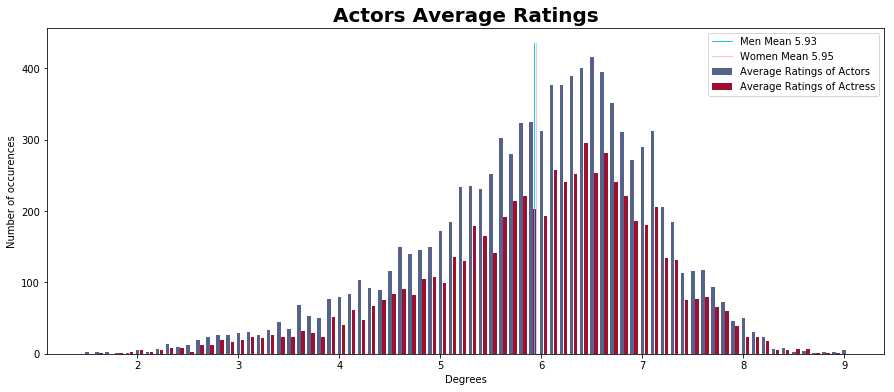

In [38]:
###########################
# Average Rating Histogram
###########################
def histProp(rMen_G,rWomen_G,full,ttl, mode):
    
    # GET Histogram
    histRatingMenG, binsRatingMenG = histogram(rMen_G,False)
    histRatingWomenG, binsRatingWomenG = histogram(rWomen_G,False)

    # Compute basic stat
    avAvRatingMen = np.mean(rMen_G)
    avAvRatingWomen = np.mean(rWomen_G)

    # Plot 
    plt.figure(figsize = (15,6))
    plt.bar([float(b/10) for b in binsRatingMenG[:-1]], histRatingMenG, 0.035, color=mBlue, label = "Average "+mode+" of Actors")
    plt.bar([float(b/10)+0.04 for b in binsRatingWomenG[:-1]], histRatingWomenG, 0.035, color=fRed, label = "Average "+mode+" of Actress")
    plt.plot([avAvRatingMen/10,avAvRatingMen/10],[0,np.max(histRatingMenG)+20], linestyle='-', linewidth = 1, color="#1dcaff", label= "Men Mean "+str(round(avAvRatingMen/10,2)))
    plt.plot([avAvRatingWomen/10,avAvRatingWomen/10],[0,np.max(histRatingMenG)+20], linestyle='-', linewidth = 1, color="#ffc0cb", label= "Women Mean "+str(round(avAvRatingWomen/10,2)))
    plt.xlabel('Degrees')
    plt.ylabel('Number of occurences')
    if full:
        plt.title('Actors Average '+mode, fontdict=title_font)
    else:
        plt.title('Actors Average '+mode+' Period '+ttl, fontdict=title_font)
    plt.legend()
    if full:
        base = 'Figures/actorsAverage'+mode
    else:
        base = 'Figures/actorsAverage'+mode+'_'+ttl
    if savingFigures:
        plt.savefig(base+'.jpeg', bbox_inches='tight')
        plt.savefig(base+'.png', bbox_inches='tight')
        plt.savefig(base+'.svg', bbox_inches='tight')
    plt.show()

histProp(ratingListMen_G,ratingListWomen_G,True,"","Ratings")

The distributions seems the same for men and women, the average are really close also. Neverthe less the proportion of women with an average rating above 8 is bigger.

In [39]:
#################
# Plot the graph
#################

#Size Rendering Function to increase readability
def ratingSizeRendering(a,b,lim):
    if b>lim:
        return 0.5*((math.exp(a-5))**2+2)
    else : 
        return 1 # for actors with less than 10 movies
    
#Size Rendering Function to increase readability For later
def sentSizeRendering(a,b,lim):
    if b>lim:
        return((math.exp((7*a-39)))+2)**1.7
    else : 
        return 1 # for actors with less than 10 movies
    

#Label the actors with the best grades and more than 10 movies
def drawWithSizes(graph,ttl,posi,sizes,full, mode):
    # minimum number of movies to be analysed 
    #(in order to exclude actor with to few data which won't be representative)
    if full: 
        lim=10  # 10 movies for the full graph
    else:
        lim=7   # 7 for period graph
        
    colors = getColors(graph)  # Build the color and size arrays

    #SIZE
    # Get the actor/actress with the biggest number of collaborations
    siz = []
    for n in graph.nodes():
        if sizes[n][1] >lim:
            siz.append([n,sizes[n][0]]) 
    
    
    SortedNames = np.asarray(sorted(siz,key=getSecond, reverse= True))
    
    SortedNames = SortedNames[:10]
    
    #PRINT THE 10 BEST ACTORS
    print ""
    print "########################"
    print "Best Actors:"
    print "------------"
    print ""
    for i in range(10):
        print str(i+1)+" - "+actorNameDict[SortedNames[i,0]]+" - "+str(round(sizes[SortedNames[i,0]][0],2))
    print ""
    print "########################"
    print ""
    labels = {}
    for n in graph.nodes():
        name = actorNameDict[n]
        if n in SortedNames[:,0]:
            labels[n]="\n\n"+name+" - "+str(round(sizes[n][0],2))
        else:
            labels[n]=""
            
    #POSITIONNING
    positions = posi
    
    #Node size 
    # Choose rendering function
    if mode == "Ratings":
        nodeSize=[ratingSizeRendering(sizes[n][0],sizes[n][1],lim) for n in graph.nodes()]
    else:
        nodeSize=[sentSizeRendering(sizes[n][0],sizes[n][1],lim) for n in graph.nodes()]
    
    
    #PLOT
    fig = plt.figure(figsize=(15, 15))
    nx.draw_networkx(graph, positions, 
                     node_size = nodeSize,  
                     node_color = [colors[n] for n in graph.nodes()],
                     with_labels=True,
                     width = 0.1,edge_color='#999999',labels = labels,font_size = 12, font_weight= "bold")
    plt.axis('off')
    if full:
        plt.title(mode+ "-Based: Actors Graph", fontdict = title_font  )
        base = 'Figures/actorGraph_'+mode+"_full"
    else:
        plt.title(mode+ "-Based: Actors Graph Period "+ttl, fontdict = title_font  )
        base = 'Figures/actorGraph_'+mode+"_"+ttl
    if savingFigures:
        plt.savefig(base+'.jpeg', bbox_inches='tight')
        plt.savefig(base+'.png', bbox_inches='tight')
        plt.savefig(base+'.svg', bbox_inches='tight')
    plt.show()


########################
Best Actors:
------------

1 - Marion Davies - 8.0
2 - Gloria Swanson - 7.9
3 - William Haines - 7.88
4 - Lucy Decoutere - 7.88
5 - Charles Chaplin - 7.78
6 - Paulette Goddard - 7.7
7 - Aleksandar Bercek - 7.65
8 - Louis Jouvet - 7.65
9 - Lisa Ann Beley - 7.63
10 - Aamir Khan - 7.6

########################



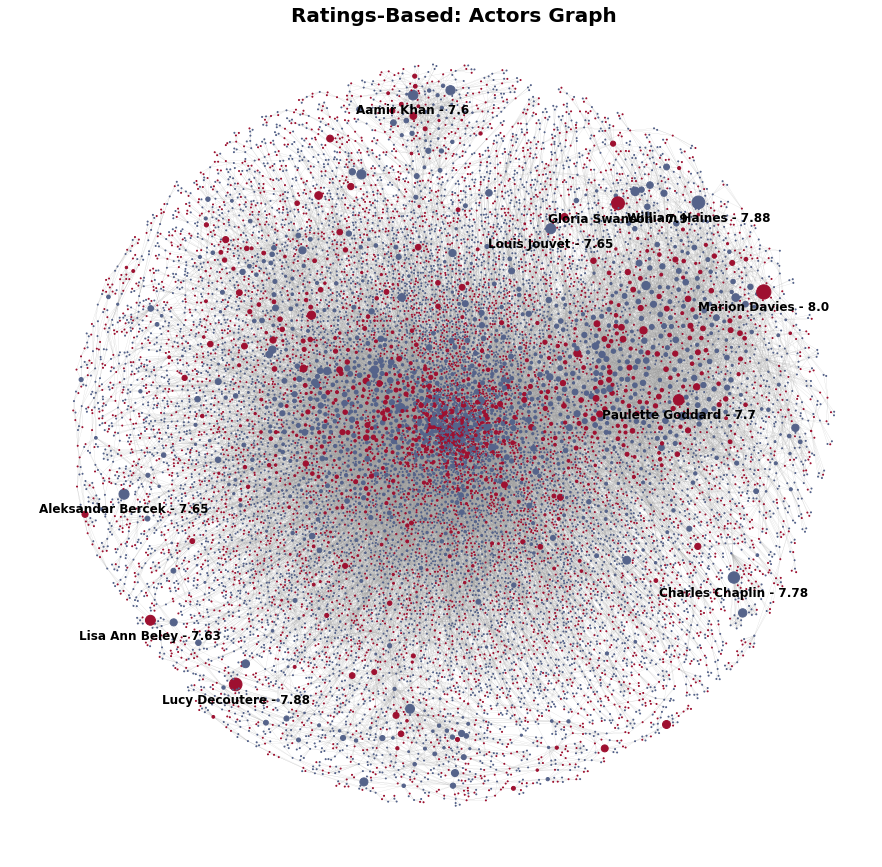

In [40]:
drawWithSizes(G_ratings,"",pos,ratingDict_G,True,"Ratings")

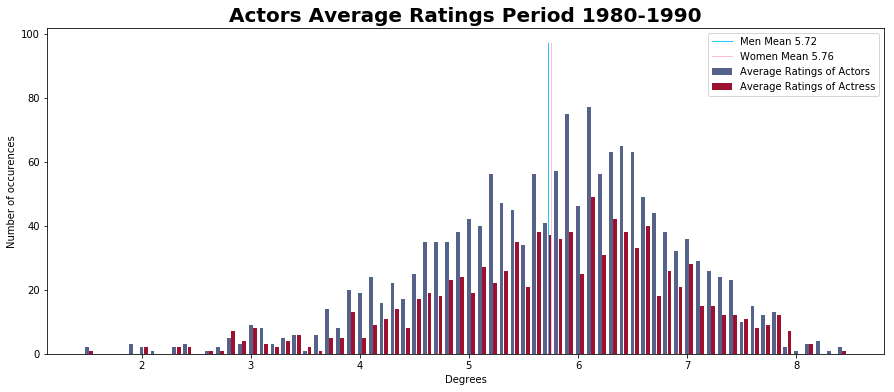


########################
Best Actors:
------------

1 - Harrison Ford - 7.53
2 - Danny Glover - 7.4
3 - Steven Bauer - 7.37
4 - Willem Dafoe - 7.32
5 - Robert De Niro - 7.32
6 - Bernard-Pierre Donnadieu - 7.27
7 - Stephen Dorff - 7.2
8 - Matthew Modine - 7.2
9 - Ed Harris - 7.17
10 - Eric Idle - 7.17

########################



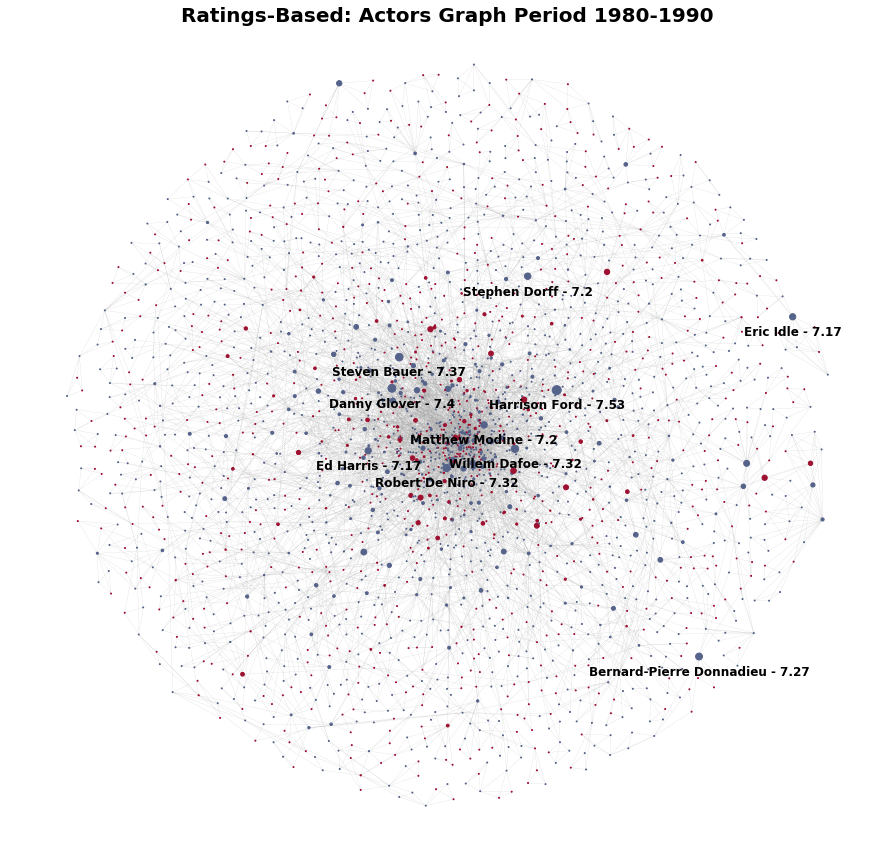

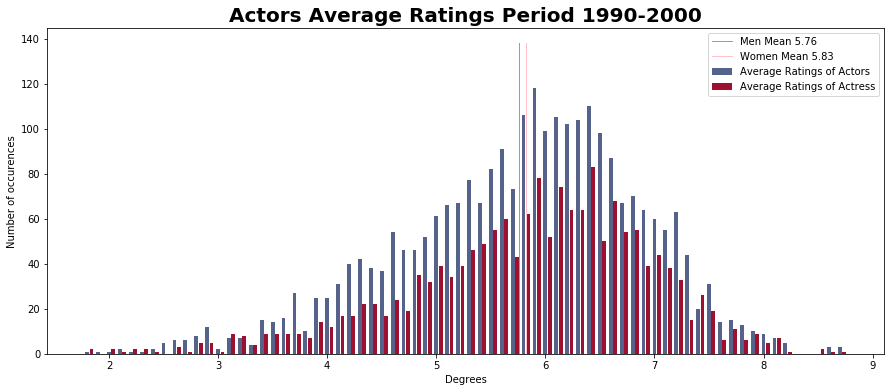


########################
Best Actors:
------------

1 - Jermaine Holloway - 8.0
2 - Timothy J. Lonsdale - 8.0
3 - Lori Rom - 8.0
4 - Aaron Spelling - 8.0
5 - Sean Bean - 7.64
6 - Richard Lewis - 7.57
7 - Tony Chiu-Wai Leung - 7.47
8 - Steve Buscemi - 7.47
9 - Johnny Depp - 7.47
10 - Sally Field - 7.4

########################



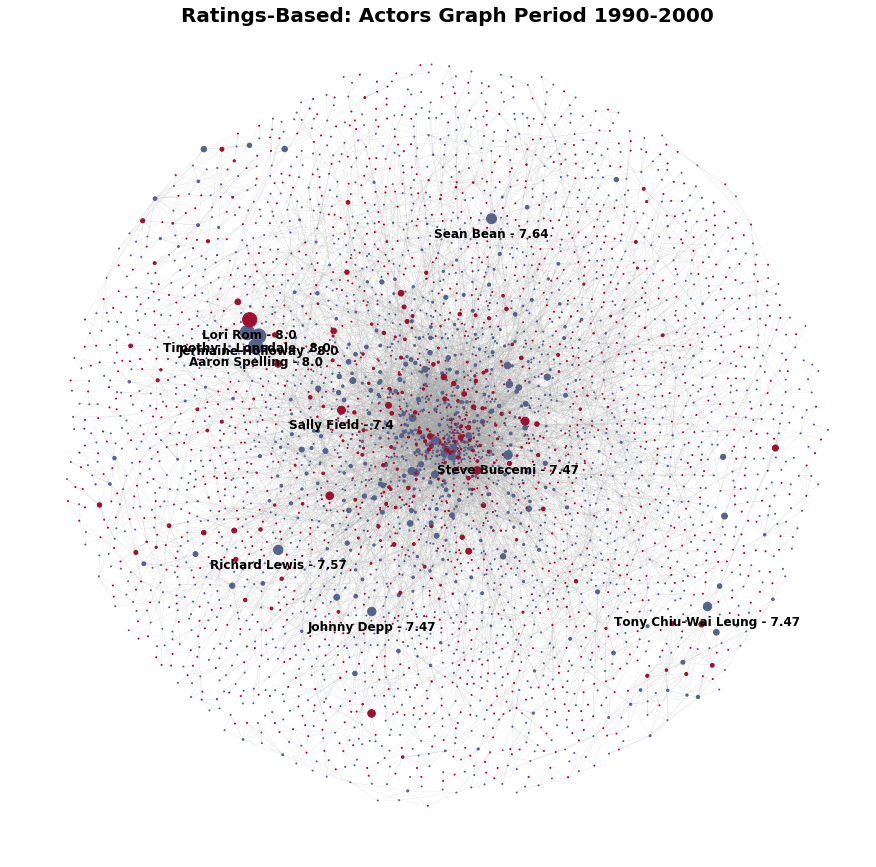

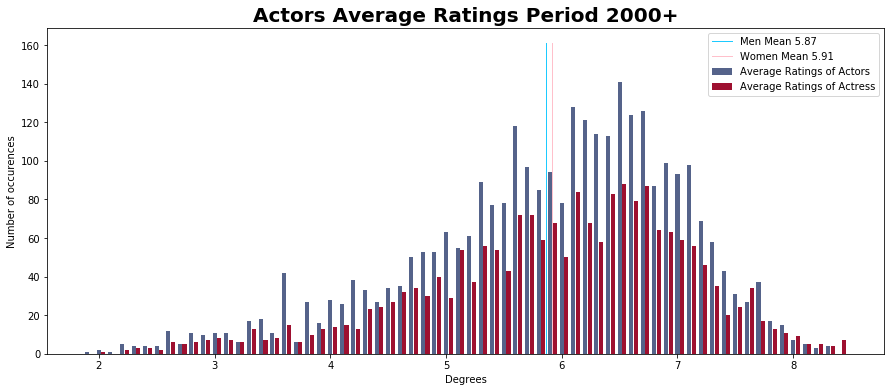


########################
Best Actors:
------------

1 - Sean Bean - 7.77
2 - Leonardo DiCaprio - 7.7
3 - Kay Kay Menon - 7.67
4 - Tony Chiu-Wai Leung - 7.66
5 - Luigi Lo Cascio - 7.53
6 - Javier Bardem - 7.53
7 - Kiron Kher - 7.51
8 - Suriya - 7.47
9 - Kamal Haasan - 7.47
10 - Jyothika - 7.46

########################



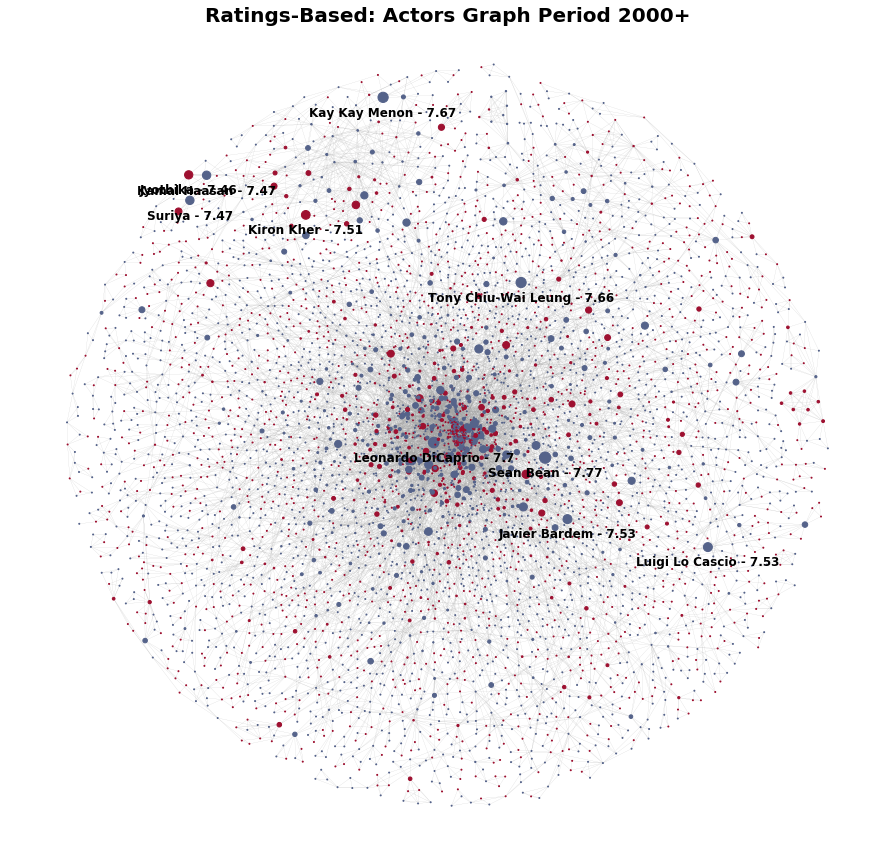

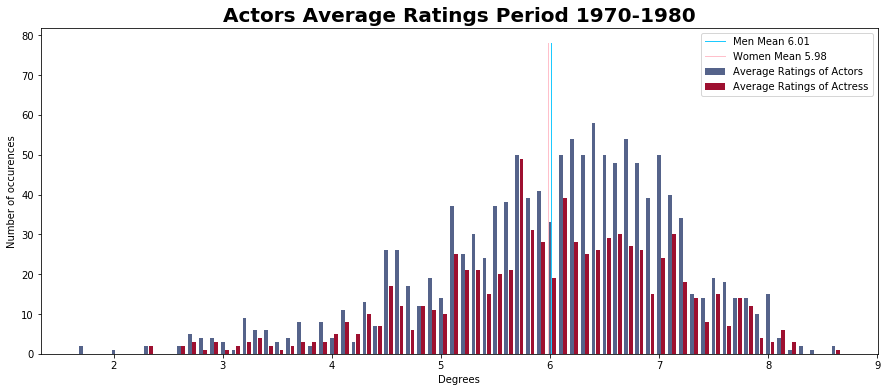


########################
Best Actors:
------------

1 - Gena Rowlands - 7.9
2 - Dustin Hoffman - 7.78
3 - Yves Montand - 7.63
4 - Bernadette Lafont - 7.6
5 - Eva Mattes - 7.5
6 - Geraldine Page - 7.5
7 - Robert Redford - 7.43
8 - Diane Keaton - 7.4
9 - Orson Welles - 7.38
10 - Peter Falk - 7.37

########################



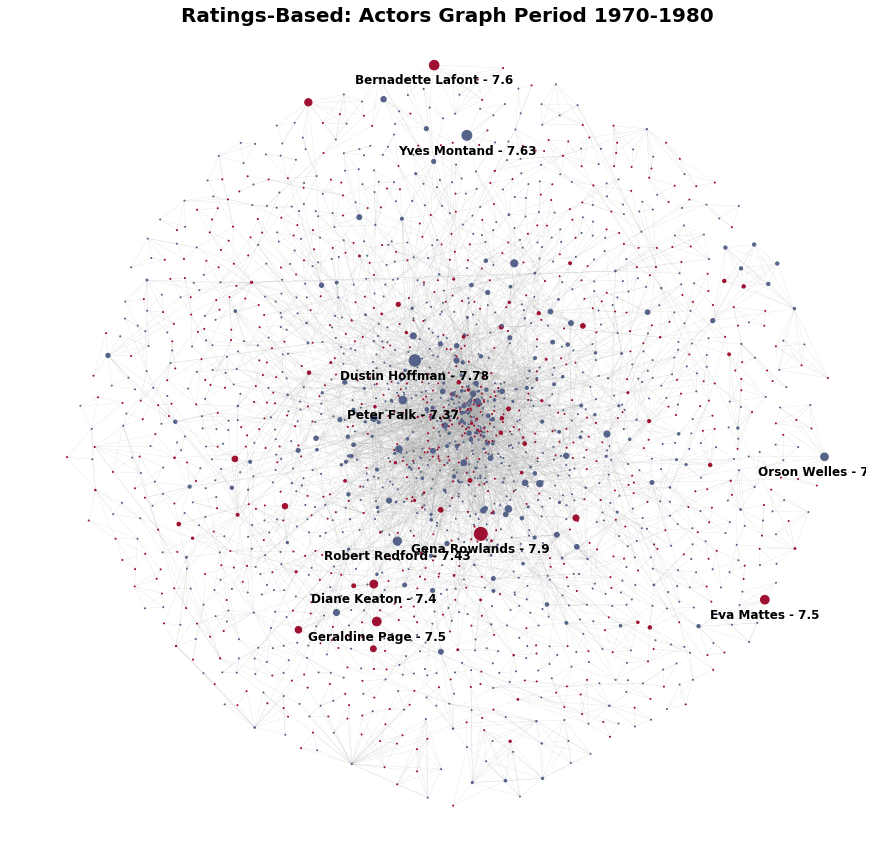

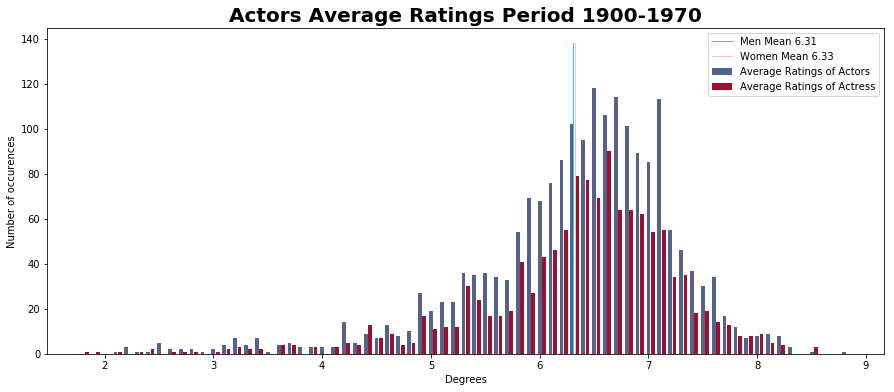


########################
Best Actors:
------------

1 - Tiny Sandford - 8.1
2 - John Rand - 8.1
3 - Merna Kennedy - 8.1
4 - George Davis - 8.1
5 - Harry Crocker - 8.1
6 - Al Ernest Garcia - 8.1
7 - Steve Murphy - 8.1
8 - Marion Davies - 8.0
9 - Gloria Swanson - 7.9
10 - William Haines - 7.88

########################



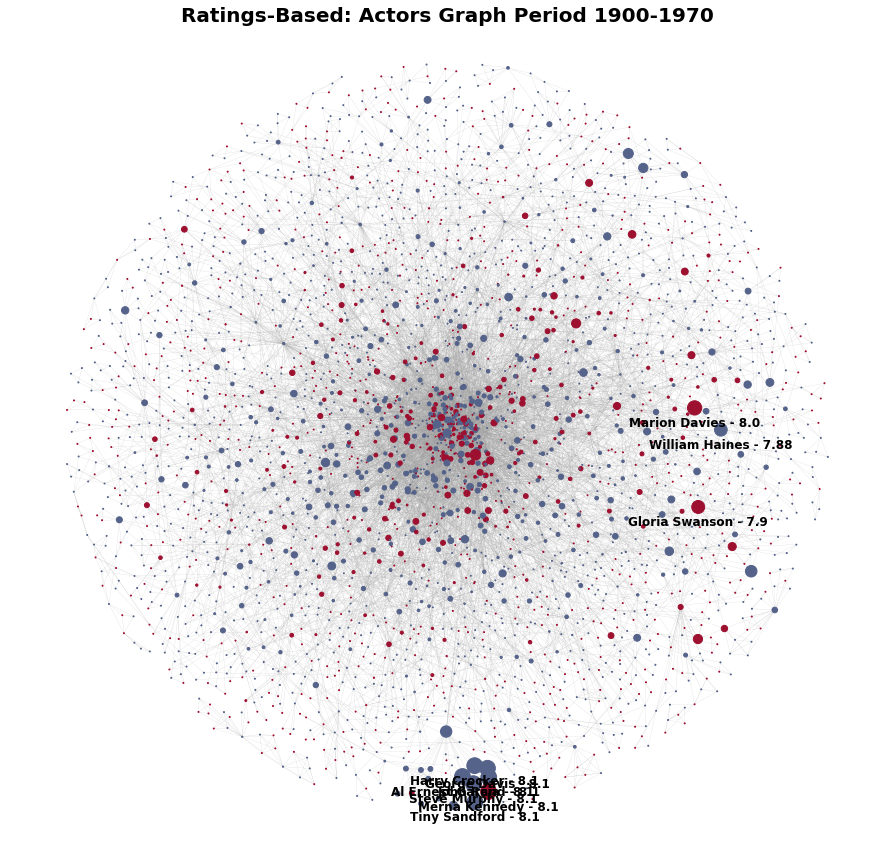

In [41]:
################################
# Apply it to the period graphs
################################
#ratingDict_G,ratingListMen_G,ratingListWomen_G,G_ratings
ratingDict_period = {}
ratingListMen_period = {}
ratingListWomen_period = {}
ratingGraph_period = {}
for key in graphByPeriod.keys():
    #Collect Data
    d,m,w,g = ratingWeight(graphByPeriod[key])
    ratingDict_period[key]=d
    ratingListMen_period[key]=m
    ratingListWomen_period[key]=w
    ratingGraph_period[key]=g
    #Histogram
    histProp(m,w,False,titles[key],"Ratings")
    #Graph
    drawWithSizes(g,titles[key],positionsPeriod[key],d,False,"Ratings")

Drawing the graphs, we observe that some small group of actor really close can have together high grades as in the bottom of the old movies graph. It corresponds to actor that have made a lot of movies toghether that got good ratings. On the histograms, we see that men and women ratings are really similar.

Let's run the community detection with the weight as average ratings to see if new communities can be found using Louvain algorithm.

The partition made of the graph has a modularity of +69.358% and contains 118 communities.


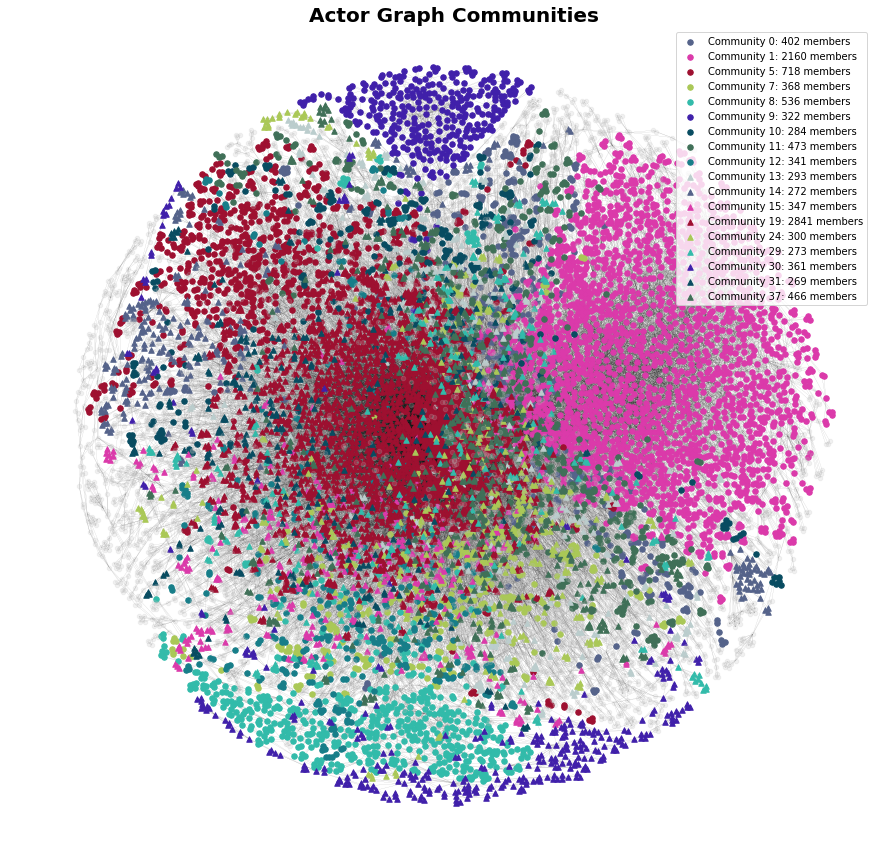

In [42]:
#############################################
# RUN COMMUNITY DETECTION FOR THE FULL GRAPH
#############################################

partRatingG,modulRatingG = communityDetect(G_ratings)
biggestCommunitiesLabelRating = drawCommunities(G_ratings,partRatingG,"full_Ratings",pos, True)

The communities found are very close to the ones found with the number of collaboration as weight. Community 14, we could not see before, (grey triangles) corresponds to Spannish actors. 

In [43]:
#########################
# ANALYSE THE FULL GRAPH
#########################
files = io.open("Full_communityAnalysis_Ratings.txt", mode="w", encoding="utf-8" )
s = communityExplain(G_ratings,partRatingG,biggestCommunitiesLabelRating, "av. Rating",10)
print s
files.write(s)
files.close()


 
####################################### 
Community: 0
####################################### 
 
Members:402
Main Actors: Peter Cushing (6.176190476190476 av. Rating) 
Year: 1915.0-2008.0  Av: 1973.83  Std: 16.82
Ratings: 2.3-8.3  Av: 6.03  Std: 1.22
Main Movies: Sudden Fury (21.0 times) Dans la ville de Sylvia (15.0 times) Son of Dracula (15.0 times) Romeo & Juliet (10.0 times) Let It Be (10.0 times) 
Sentiments: 4.96-6.14933  Av: 5.67754  Std: 0.15863


 
####################################### 
Community: 1
####################################### 
 
Members:2160
Main Actors: Fredric March (7.204411764705879 av. Rating) James Stewart (7.152499999999998 av. Rating) Henry Fonda (7.1078947368421055 av. Rating) Bette Davis (7.049435028248591 av. Rating) Tyrone Power (7.046875 av. Rating) 
Year: 1917.0-2005.0  Av: 1946.11  Std: 12.57
Ratings: 1.8-8.9  Av: 6.4  Std: 0.92
Main Movies: Glen or Glenda (21.0 times) The Star Packer (21.0 times) The Lawless Frontier (21.0 times) Dishonored (2

### Sentiments :

First thing to do is to build sentiment-based graph. Let's define a function to do so, in order to apply it to all the graphs we have.</br>

This function also gives a size dictionnary with sizes proportionnal to the average sentiment score of actors, and a sentiment list to draw an histogram of the average sentiment score of actors.

In [44]:
############################
# Sentiment Weight Function
############################
def sentimentWeight(graph):
    res = graph.copy()
    sentDict = {}
    sentListMen = []
    sentListWomen = []
    for n in res.nodes(): #go through nodes
        avSent = 0
        countNeighbors = 0
        for n2 in res.neighbors(n): #go through neighbors to go throught edges
            countNeighbors +=1  #set counts
            sentScore = 0
            countMovies = 0
            for m in res[n][n2]["movies"]: # go throught movies
                countMovies +=1 
                sentScore += sentimentDict[m][1]*1.0/sentimentDict[m][0] # update sent score
            sentScore = sentScore/countMovies
            res[n][n2]["weight"]=sentScore
            avSent+=sentScore
        avSent = avSent/countNeighbors # compute the average sentiment
        sentDict[n] = [avSent,countNeighbors]
        if res.nodes[n]["Gender"] == "M": # update the lists
            sentListMen.append(int(round(10*avSent)))  
        else:
            sentListWomen.append(int(round(10*avSent)))
    return sentDict,sentListMen,sentListWomen,res

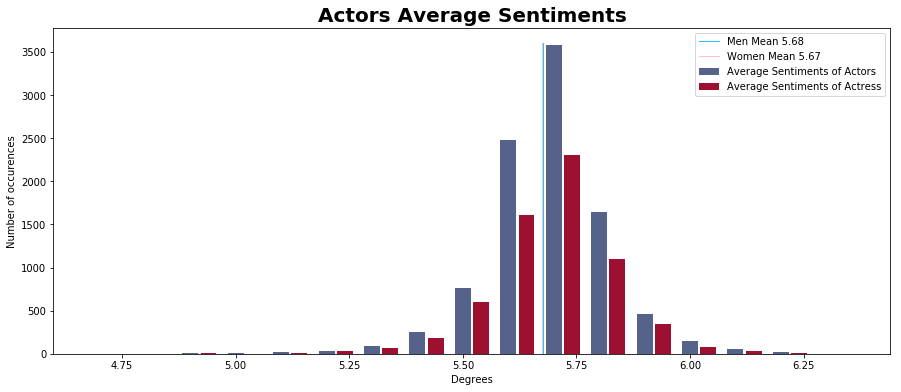

In [45]:
#############################
# Apply it to the full graph
#############################
sentDict_G,sentListMen_G,sentListWomen_G,G_sent = sentimentWeight(G)

#histogram
histProp(sentListMen_G,sentListWomen_G,True,"","Sentiments")


########################
Best Actors:
------------

1 - Sydney Greenstreet - 5.92
2 - Lainie Kazan - 5.9
3 - Lung Ti - 5.9
4 - Brooke Langton - 5.89
5 - Francisco Rabal - 5.88
6 - Alexis Smith - 5.87
7 - Sammo Kam-Bo Hung - 5.87
8 - Lew Ayres - 5.87
9 - Maury Chaykin - 5.87
10 - Thelma Todd - 5.85

########################



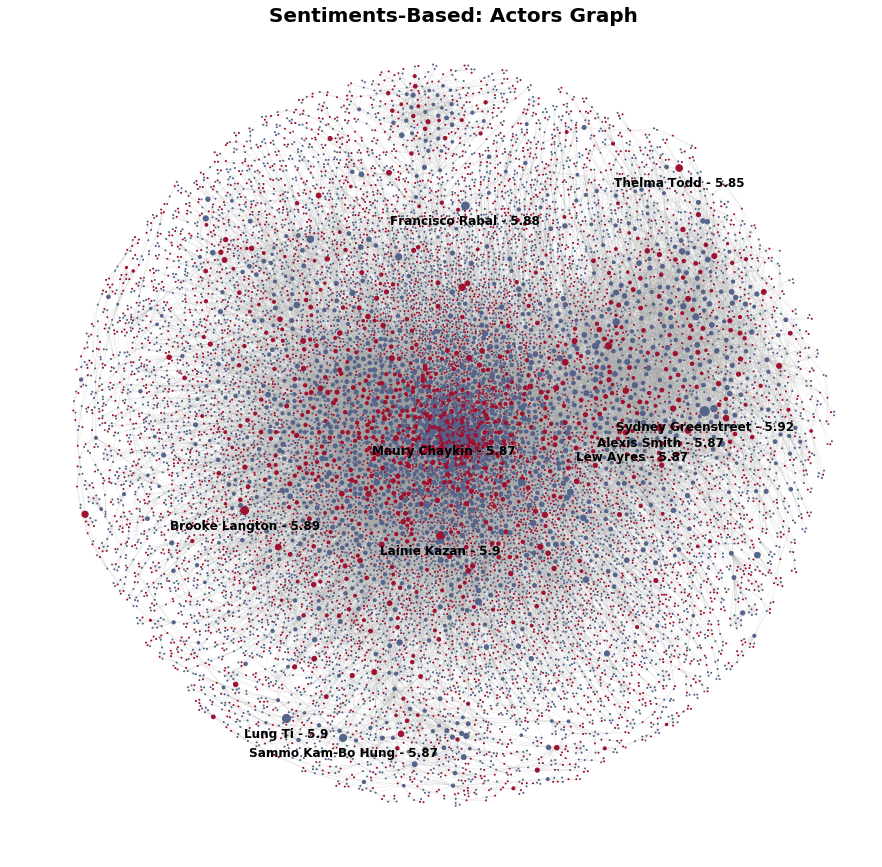

In [46]:
#################
# Plot the graph
#################
    
drawWithSizes(G_sent,"",pos,sentDict_G,True,"Sentiments")

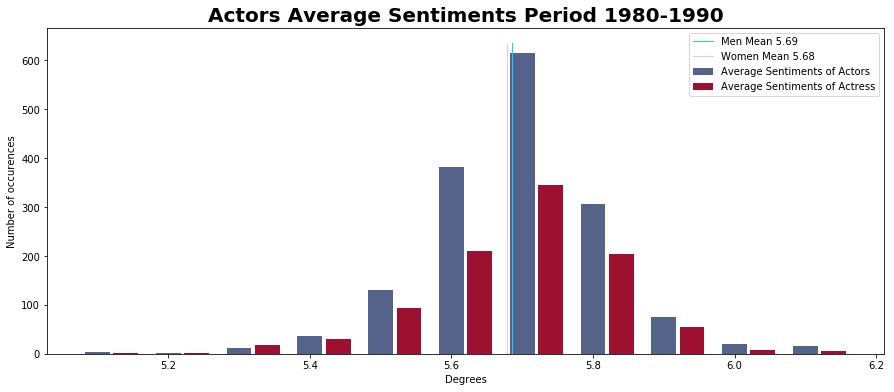


########################
Best Actors:
------------

1 - Duncan Regehr - 5.98
2 - Brenda Vaccaro - 5.87
3 - Anthony Andrews - 5.86
4 - Bernadette Peters - 5.84
5 - Jacqueline Bisset - 5.83
6 - Whoopi Goldberg - 5.83
7 - Charles Haid - 5.83
8 - Eric Idle - 5.82
9 - Michael Caine - 5.82
10 - Kenneth McMillan - 5.82

########################



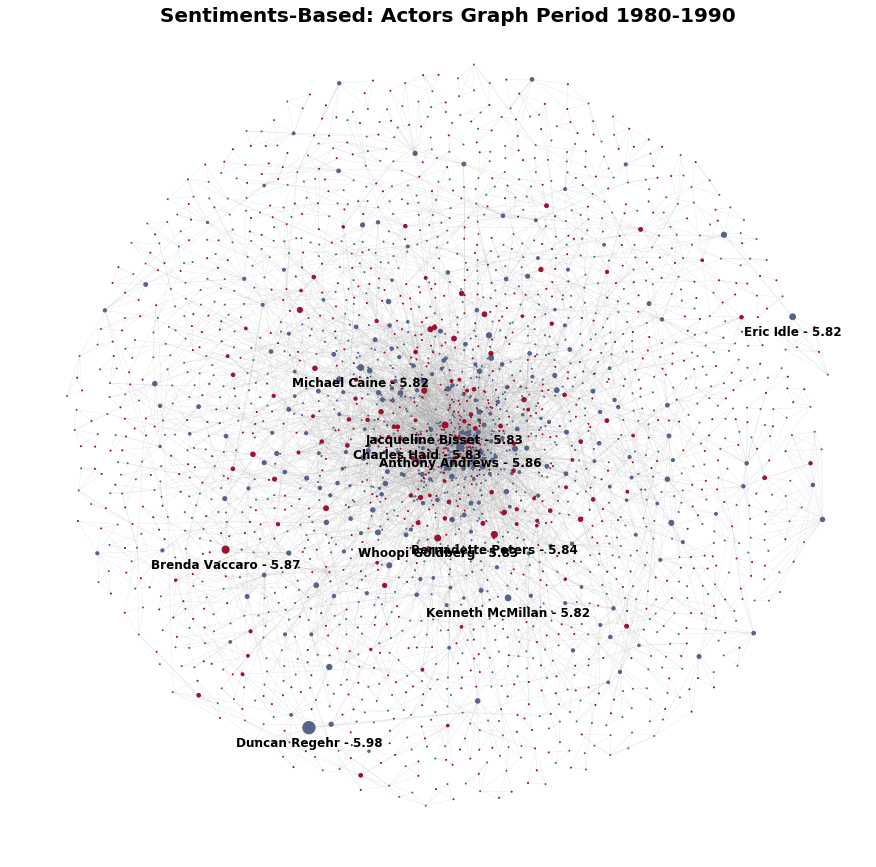

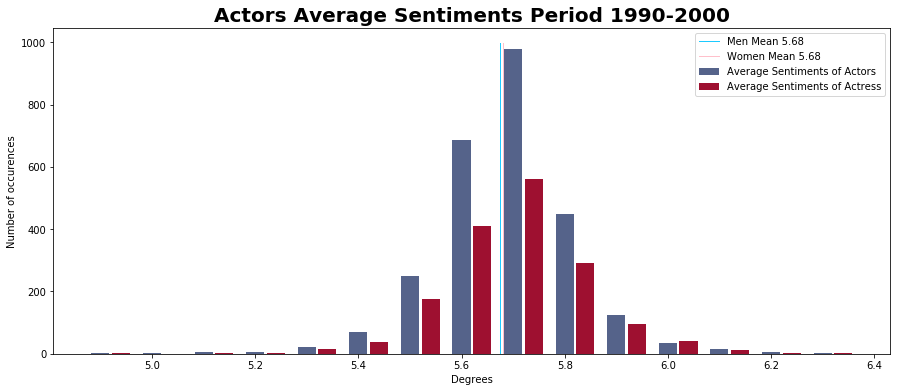


########################
Best Actors:
------------

1 - Maury Chaykin - 5.99
2 - Emilio Estevez - 5.94
3 - Ann Jillian - 5.91
4 - Maggie Cheung - 5.87
5 - Bill Nunn - 5.86
6 - Brad Johnson - 5.86
7 - John Ritter - 5.85
8 - Sarah Chalke - 5.84
9 - Ed Begley Jr. - 5.84
10 - Mickey Rourke - 5.84

########################



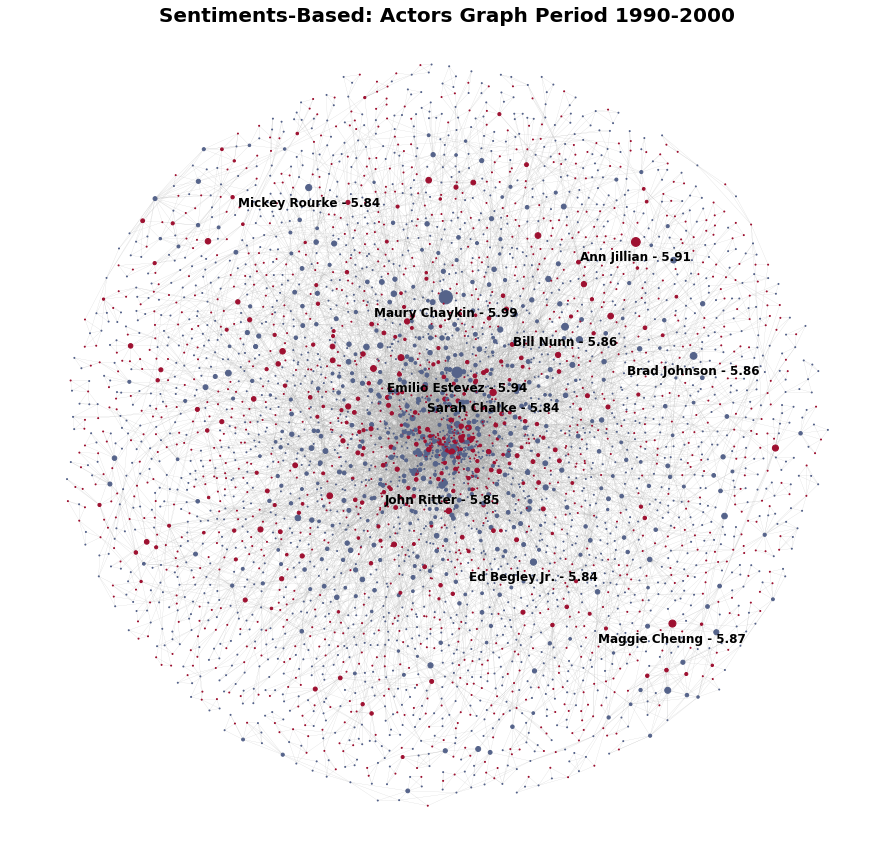

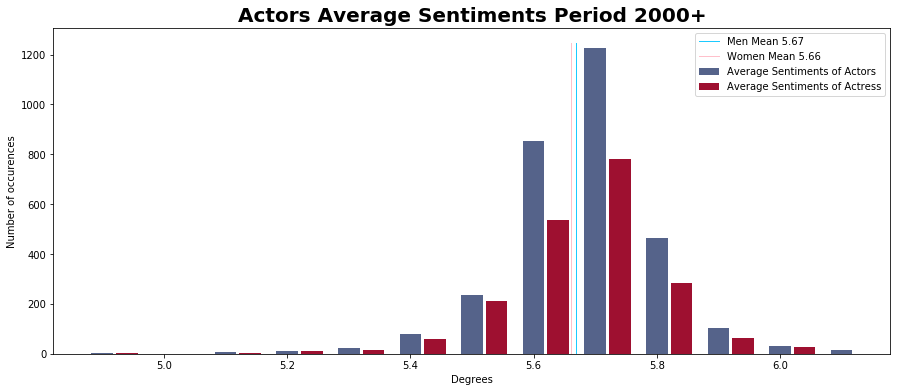


########################
Best Actors:
------------

1 - Tim Blake Nelson - 5.9
2 - Brooke Langton - 5.87
3 - Shun Sugata - 5.85
4 - Do-yeon Jeon - 5.84
5 - Olivier Gourmet - 5.82
6 - Benoît Poelvoorde - 5.82
7 - David Paymer - 5.81
8 - S. Epatha Merkerson - 5.81
9 - Javier Cámara - 5.81
10 - Ciarán McMenamin - 5.81

########################



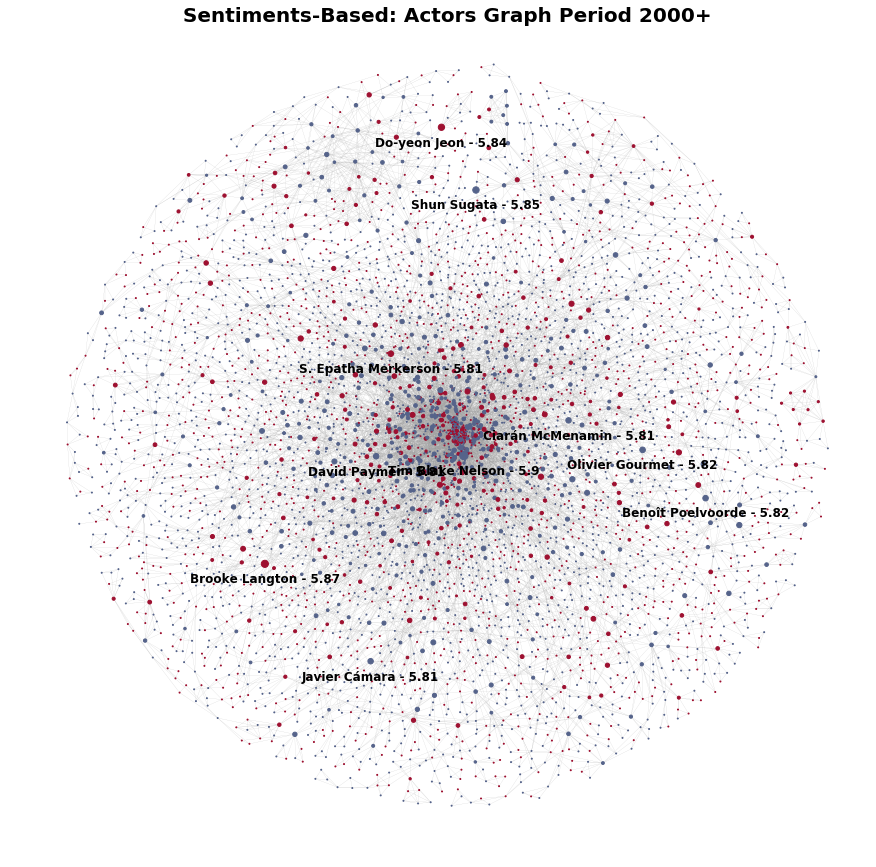

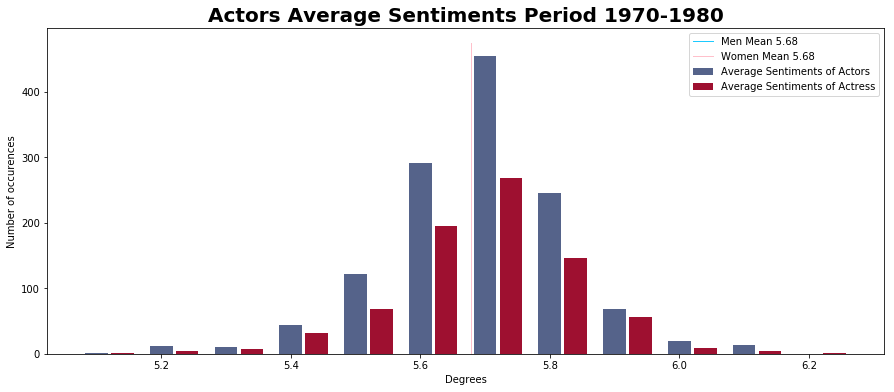


########################
Best Actors:
------------

1 - Lew Ayres - 5.9
2 - Robert Redford - 5.88
3 - Mark Burns - 5.86
4 - Burt Reynolds - 5.86
5 - John Phillip Law - 5.85
6 - Nora Miao - 5.85
7 - Robert Webber - 5.85
8 - Vanessa Redgrave - 5.84
9 - Kim Darby - 5.84
10 - James Tien - 5.83

########################



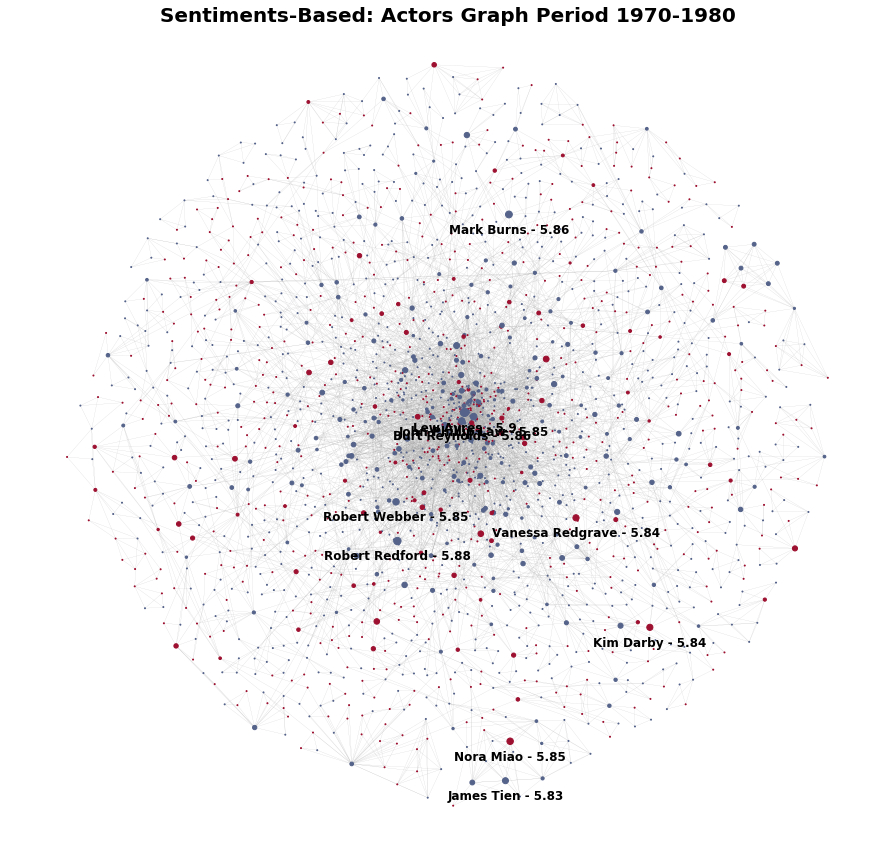

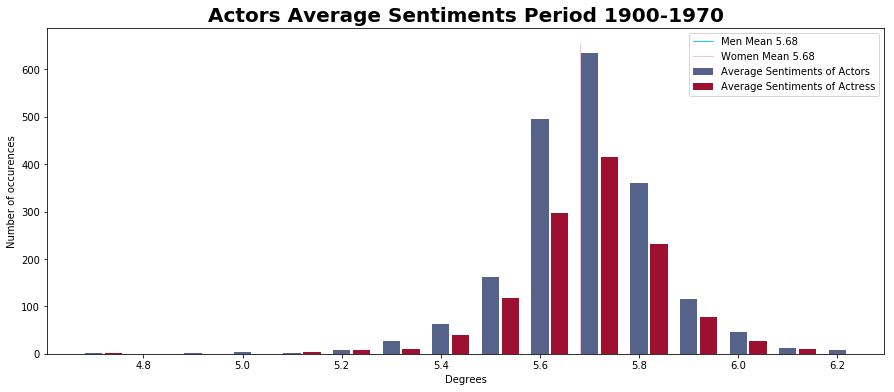


########################
Best Actors:
------------

1 - Karen Morley - 6.03
2 - Sydney Greenstreet - 5.92
3 - Claire Bloom - 5.88
4 - Albert Austin - 5.87
5 - Jack Wilson - 5.87
6 - Loyal Underwood - 5.87
7 - L.A. Blaisdell - 5.87
8 - W.J. Allen - 5.87
9 - Syd Chaplin - 5.87
10 - Edna Purviance - 5.87

########################



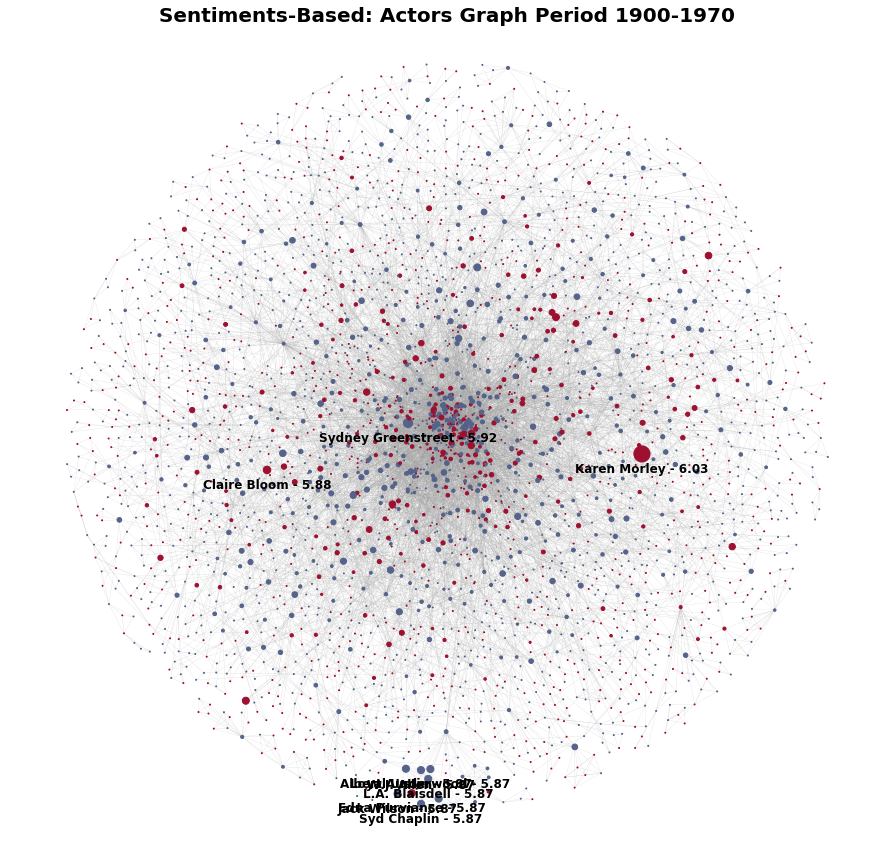

In [47]:
################################
# Apply it to the period graphs
################################
#ratingDict_G,ratingListMen_G,ratingListWomen_G,G_ratings
sentDict_period = {}
sentListMen_period = {}
sentListWomen_period = {}
sentGraph_period = {}
for key in graphByPeriod.keys():
    #Collect Data
    d,m,w,g = sentimentWeight(graphByPeriod[key])
    sentDict_period[key]=d
    sentListMen_period[key]=m
    sentListWomen_period[key]=w
    sentGraph_period[key]=g
    #Histogram
    histProp(m,w,False,titles[key],"Sentiments")
    #Graph
    drawWithSizes(g,titles[key],positionsPeriod[key],d,False,"Sentiments")

The partition made of the graph has a modularity of +68.294% and contains 80 communities.


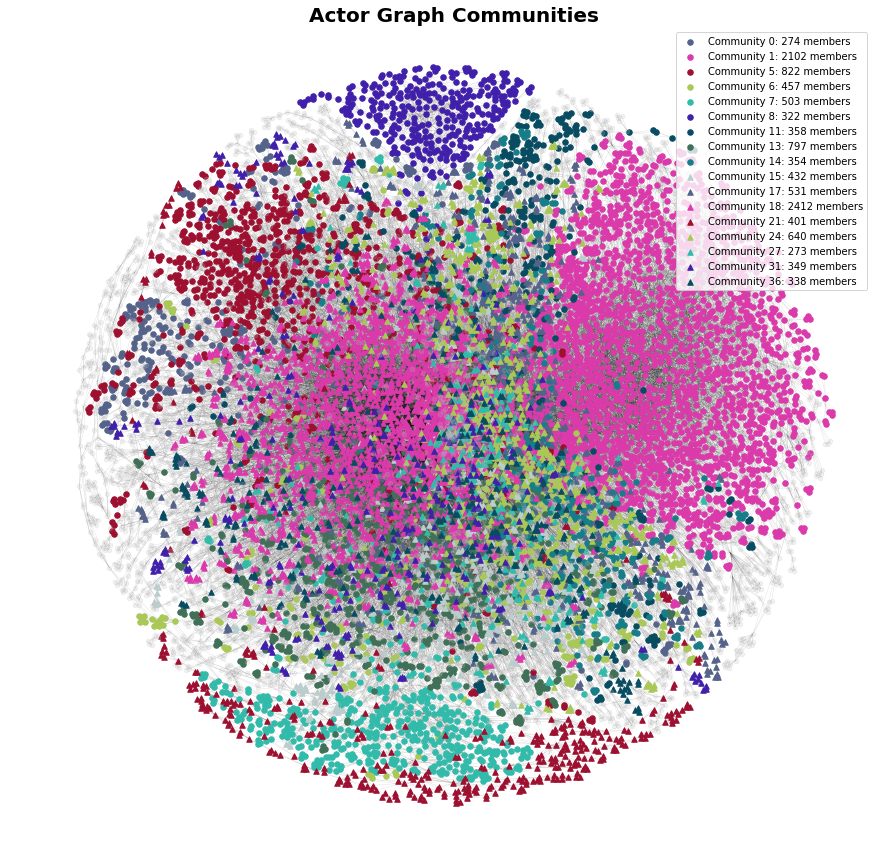

In [48]:
#############################################
# RUN COMMUNITY DETECTION FOR THE FULL GRAPH
#############################################

partSentG,modulSentG = communityDetect(G_sent)
biggestCommunitiesLabelSent = drawCommunities(G_sent,partSentG,"full_Sentiments",pos, True)

In [49]:
#########################
# ANALYSE THE FULL GRAPH
#########################
files = io.open("Full_communityAnalysis_SentimentBased.txt", mode="w", encoding="utf-8" )
s = communityExplain(G_sent,partSentG,biggestCommunitiesLabelSent, "av. Sentiment score",10)
print s
files.write(s)
files.close()


 
####################################### 
Community: 0
####################################### 
 
Members:274
Main Actors: 
Year: 1972.0-2007.0  Av: 1996.46  Std: 9.5
Ratings: 3.1-8.0  Av: 6.36  Std: 1.08
Main Movies: Los ritos sexuales del diablo (21.0 times) La ley del deseo (21.0 times) Las garras de Lorelei (15.0 times) ¿Qué he hecho yo para merecer esto? (15.0 times) Dans la ville de Sylvia (15.0 times) 
Sentiments: 5.22757-6.05842  Av: 5.67111  Std: 0.13895


 
####################################### 
Community: 1
####################################### 
 
Members:2102
Main Actors: Basil Rathbone (5.78656855567 av. Sentiment score) Ricardo Cortez (5.77117512794 av. Sentiment score) James Stewart (5.77007894453 av. Sentiment score) Lana Turner (5.76443507898 av. Sentiment score) Frank McHugh (5.76295194567 av. Sentiment score) 
Year: 1917.0-1997.0  Av: 1945.85  Std: 12.41
Ratings: 1.8-8.9  Av: 6.4  Std: 0.94
Main Movies: Glen or Glenda (21.0 times) The Star Packer (21.0 times) T

Sentiments scores range is really small and then we do not see a lot of difference between actors. Nonetheless the communtity graph is slightly different: we see the spanish community and there is more difference between old and new movies.

In [1]:
# Import Libraries
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import json
import re
import fa2
import math
import community
import matplotlib.cm as cm
from __future__ import division
import matplotlib.image as mpimg
from nltk.tokenize import RegexpTokenizer
from nltk.corpus import stopwords
import io
from collections import Counter
from wordcloud import WordCloud
# Rendering Parameters
title_font = {'family': 'sans-serif',
        'color':  '#000000',
        'weight': 'normal',
        'size': 16,
        }

## Sentiment Scores
To calculate sentiment scores, we used the naive sentiment algorithm as described in [Dodds, 2011]. The sentiment is calculated as the sum of the sentiments scores of each word in the reviews multiplied by the frequency of that word if the word has a defined score which is defined as 
![alt text](https://journals.plos.org/plosone/article/file?type=thumbnail&id=info:doi/10.1371/journal.pone.0064417.e007 "Sentiment Score")
This sentiment for individual words are used as in [Dodds, 2011] with 11000 words where 50 humans have evaluated the words sentiment.

This analysis is simply to look at the distribution of these scores for each review to see what prior is represented in the data.

We defined a function that takes dictionaries due to look-up efficiency.

In [2]:
#Loading
dict_to_compare = {}
newfile = io.open("Data_Set_S1.txt", mode="r", encoding="utf-8")
count = 0
for row in newfile:
    if count < 4:
        count +=1
        continue
        
    string = row.split("\t")
    dict_to_compare[string[0]] = float(string[2])

def happiness(dict_of_tokens,dict_to_compare):
    #dict_of_tokens is the tokenized dictionary with their count (token: count)
    #dict_to_compare is a dictionary that contains word as key and the averaged_happiness_weight as value
    #Return 0 if no tokens
    if len(dict_of_tokens)==0:
        return 0
    #Sum of token frequency multiplied with the averaged_happiness_weight as in (1) from the paper[Dodds, 2011]
    keys = [key for key in dict_of_tokens if key in dict_to_compare.keys()]
    #Normalization can only be calculated after keys since "for which we have an estimate of average happiness"[Dodds, 2011] applies
    normalization = sum(dict_of_tokens[key] for key in keys)
    #Return 0 if no word is present in dict_to_compare
    if normalization==0:
        return 0
    sums = sum(dict_to_compare[key]*dict_of_tokens[key] for key in keys)
    return sums/normalization

Just some data loading. You need to download the folder structure as of https://www.kaggle.com/iarunava/imdb-movie-reviews-dataset.
We used regular expressions to find the IMDb id in each file and match it with their patch, so the sentiment could be stored correctly.

In [3]:
#Create dictionaries for sentiment and reviews matching index in Large Movie Review Dataset
moviereviews = {}
moviesentement = {}
#Initialize sentiment and load index for movies in Large Movie Review Dataset
for filename in os.listdir("aclImdb/test"):
    if filename.endswith(".txt"):
        text = re.findall("urls_(\w*).txt",filename)
        with open("aclImdb/test/"+filename) as file:
            for idx,line in enumerate(file):
                ID = re.findall("http://www.imdb.com/title/(\w*)/usercomments",line)
                moviereviews[(idx,"test/"+text[0])] = ID[0]
                moviesentement[ID[0]] = [0,0]
#Same as above for other directory
for filename in os.listdir("aclImdb/train"):
    if filename.endswith(".txt"):
        text = re.findall("urls_(\w*).txt",filename)
        with open("aclImdb/train/"+filename) as file:
            text = re.findall("urls_(\w*).txt",filename)
            for idx,line in enumerate(file):
                ID = re.findall("http://www.imdb.com/title/(\w*)/usercomments",line)
                moviereviews[(idx,"train/"+text[0])] = ID[0]
                moviesentement[ID[0]] = [0,0]

Tokenize the reviews and calculate the weighted sentiment score. Sentiment score for same movie is added to the movie and the count of reviews for the movie is also recorded. We use io.open to handle unicode exceptions and use regular expressions to filter websites, HTML formatting and tags in the reviews. The analysis takes around 45 minuttes. Scores are stored independently to see the statistics of the reviews themselves.

In [4]:
#Define tokens, stopwords and path
stopwordslist = set(stopwords.words('english'))
tokenizer = RegexpTokenizer(r'\w+')
paths = ["train/unsup","train/pos","train/neg","test/neg","test/pos"]
scores = []
for path in paths:
    done = len(os.listdir("aclImdb/"+path))
    for idx,filename in enumerate(os.listdir("aclImdb/"+path)):
        file = io.open("aclImdb/"+path+"/"+filename, mode="r", encoding="utf-8")
        string = file.readlines()[0]
        #Strip for websites, tags and HTML formatting
        w = re.findall(r'@\w*', string)
        for i in range(0, len(w)):
            string = string.replace(w[i], "")
        w = re.findall('https?://(?:[-\w.]|(?:%[\da-fA-F]{2}))+[\/\w+]*', string)
        for i in range(0, len(w)):
            string = string.replace(w[i], "")
        w = re.findall("<[^>]*>",string)
        for i in range(0, len(w)):
            string = string.replace(w[i], "")
        string = re.sub(r'\d+', '', string)
        #Set to lowercase and tokenize
        string = string.lower()
        filtered = tokenizer.tokenize(string)
        #Remove stopwords
        filtered = [w for w in filtered if w not in stopwordslist]
        review = Counter(filtered)
        #Calculate sentiment
        score = happiness(review,dict_to_compare)
        moviesentement[moviereviews[(idx,path)]][0] += 1
        moviesentement[moviereviews[(idx,path)]][1] += score
        scores.append(score)
        #Progress bar due to VERY large dataset
        if idx/done*100%10==0:
            print("Done with {0}% in the corresponding folder {1}.".format(idx/done*100,path))

We save the file of the movie sentiment to another analysis to be used later.

In [5]:
#Save to file so process does not have to be repeated
with open('sentiment.txt', 'w') as file:
     file.write(json.dumps(moviesentement))

In [6]:
#---------------------
# HISTOGRAM FUNCTION FOR CONTINUES VALUES
#---------------------

def histogramCont(degrees,nb_bins):
    # Computing Bins
    min_bin = np.amin(degrees)
    max_bin = np.amax(degrees)
    
    #Hist
    hist, bin_edges = np.histogram(degrees,bins = nb_bins+1)
    return hist, bin_edges

Histogram for a distribution of the sentiment.

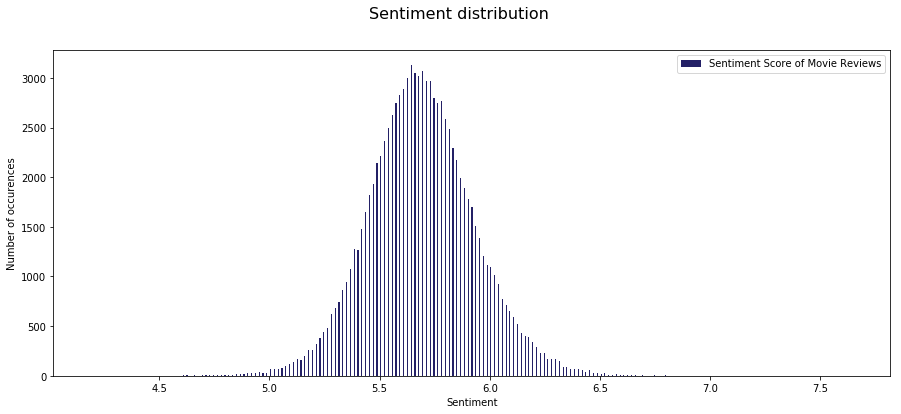

Average of average weighted happiness in review: 5.698057216744183
Standard deviation of average weighted happiness in review: 0.24207052989735794


In [7]:
Blue = "#232066"
nbins= 200
# Get the histograms
hist, bins = histogramCont(scores,nbins)
plt.figure(figsize = (15,6))
plt.bar(bins[:-1], hist, 1/nbins, color=Blue, label = "Sentiment Score of Movie Reviews") #0 exlcuded due to no sentiment
plt.xlabel('Sentiment')
plt.ylabel('Number of occurences')
plt.suptitle('Sentiment distribution', fontsize=16)
plt.legend()
plt.savefig("Figures/SentimentHistogram.svg")
plt.savefig("Figures/SentimentHistogram.jpeg")
plt.savefig("Figures/SentimentHistogram.png")
plt.savefig("Figures/SentimentHistogram.pdf")
plt.show()
print "Average of average weighted happiness in review: " + str(np.mean(scores))
print "Standard deviation of average weighted happiness in review: " + str(np.std(scores))

Now we have gotten to the end of this analysis step. We clearly see a normal distribution of the reviews. Since this dataset had to have balance, the selection criteria for the reviews biases the reviews in such way. This can affect both the sentiment as edge weight for the community analysis and what frequent words appear for negative and positive reviews.

## Frequent words for positive and negative reviews
Now that the scores has been determined, we can sort the reviews in positive and negative reviews. If we set the bar to a sentiment score of $\mu\pm2\sigma$, we get around $2.5\%$ most positive and $2.5\%$ most negative reviews since the empirical prior is normal.
When these reviews are sorted, we can compare the tokens of all positive and negative reviews the Term Frequency - Inverse Document Frequency (TF-IDF). 
TF is defined as
![alt text](https://wikimedia.org/api/rest_v1/media/math/render/svg/91699003abf4fe8bdf861bbce08e73e71acf5fd4 "Term Frequency")
where $f_t$ is the number of occurences of the word in a document. IDF is defined as
![alt text](https://wikimedia.org/api/rest_v1/media/math/render/svg/864fcfdc0c16344c11509f724f1aa7081cf9f657 "Inverse Document Frequency")
where $N$ is the number of documents and $n_t$ is the number of occurences of the term in the $N$ documents.
TF-IDF makes sense since the frequent words in both negative and positive reviews are excluded.
These TF-IDFs for the tokens can then be included in a word cloud to represent the positive and negative tokens.

Loading the reviews again but this time sorting them in positive and negative reviews. Same preprocessing as before.

In [8]:
positiveReviews = []
negativeReviews = []
mu = np.mean(scores)
sig = np.std(scores)
for path in paths:
    done = len(os.listdir("aclImdb/"+path))
    for idx,filename in enumerate(os.listdir("aclImdb/"+path)):
        file = io.open("aclImdb/"+path+"/"+filename, mode="r", encoding="utf-8")
        string = file.readlines()[0]
        #Strip for websites, tags and HTML formatting
        w = re.findall(r'@\w*', string)
        for i in range(0, len(w)):
            string = string.replace(w[i], "")
        w = re.findall('https?://(?:[-\w.]|(?:%[\da-fA-F]{2}))+[\/\w+]*', string)
        for i in range(0, len(w)):
            string = string.replace(w[i], "")
        w = re.findall("<[^>]*>",string)
        for i in range(0, len(w)):
            string = string.replace(w[i], "")
        string = re.sub(r'\d+', '', string)
        #Set to lowercase and tokenize
        string = string.lower()
        filtered = tokenizer.tokenize(string)
        #Remove stopwords
        filtered = [w for w in filtered if w not in stopwordslist]
        review = Counter(filtered)
        #Calculate sentiment
        score = happiness(review,dict_to_compare)
        #Sort in negative and positive reviews
        if score <=(mu-2*sig):
            negativeReviews=np.concatenate((negativeReviews,filtered))
        elif score>=(mu+2*sig):
            positiveReviews = np.concatenate((positiveReviews,filtered))
        #Progress bar due to VERY large dataset
        if idx/done*100%10==0:
            print("Done with {0}% in the corresponding folder {1}.".format(idx/done*100,path))

Defining a function for the TF-IDF. A lot of comprehensions for speed-up.

In [10]:
def TFIDF(doc, docs_to_compare):
    #Doc is the document (dict with count as value) for which TDIDF is caluclated
    #docs_to_compare is a list of documents (same format as above) to be compared with
    length = float(sum(doc.values()))
    #Dual comprehension for speedup (casted to C)
    return Counter({key: float(value)/length*math.log(float(len(docs_to_compare)+1)/float(1+sum(1 for docs in docs_to_compare if key in docs.keys()))) for key,value in doc.items()})

In [11]:
#TF-IDF
NegativeCounter = Counter(negativeReviews)
PositiveCounter = Counter(positiveReviews)
NegativeTFIDF = TFIDF(NegativeCounter,[PositiveCounter])
PositiveTFIDF = TFIDF(PositiveCounter, [NegativeCounter])

Defining WordClouds

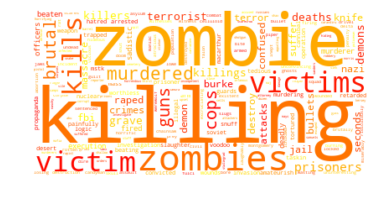

In [32]:
#Wordclouds
wordcloud = WordCloud(background_color='white',colormap = "autumn")
wordcloud.generate_from_frequencies(frequencies=NegativeTFIDF)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.savefig("Figures/NegativeCloud.svg")
plt.savefig("Figures/NegativeCloud.jpeg")
plt.savefig("Figures/NegativeCloud.png")
plt.savefig("Figures/NegativeCloud.pdf")
plt.show()

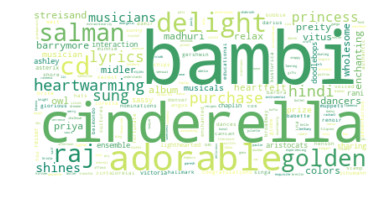

In [82]:
#Wordclouds
wordcloud = WordCloud(background_color='white', colormap="summer")
wordcloud.generate_from_frequencies(frequencies=PositiveTFIDF)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.savefig("Figures/PositiveCloud.svg")
plt.savefig("Figures/PositiveCloud.jpeg")
plt.savefig("Figures/PositiveCloud.png")
plt.savefig("Figures/PositiveCloud.pdf")
plt.show()

An interesting thing we note when the reviews are filtered for each other is that the positive sentiment tokens represent Disney movies and musicals! Negative sentiment represent horror and action movies. Thus the extremes of the reviews does not reflect if the movie is really good or really bad but more what genre it is. We did not expect this, however it makes a lot of sense. Sentiment for typical horror franchices is rated negatively and thus the review is reflected. Think of the following horror review; "This movie is so scary and creepy!". Not exactly the best sentiment will come out of the review. But is this a bad review for a horror movie? This calls for another analysis!

## Correlation of rating and sentiment
Due to previous analysis indicated that review sentiment represented genres more than if the movie was good or bad, we wanted to analyze the correlation of the rating and the sentiment of the movie.
Due to some movies also are represented less, we wanted to weight the sentiment of the movies as well to see if that has an effect on the correlation. 

Load of movie ratings. This is done as when the graph was made.

In [33]:
###################################
# Initialise a movie dictionnary
###################################

# Function. to convert movie or actor id to sting key
def idToString(iD, base): # base = "tt" for movies or "nm" for actors
    if iD<10:
        return base+"000000"+str(iD)
    if iD<100:
        return base+"00000"+str(iD)
    if iD<1000:
        return base+"0000"+str(iD)
    if iD<10000:
        return base+"000"+str(iD)
    if iD<100000:
        return base+"00"+str(iD)
    if iD<1000000:
        return base+"0"+str(iD)
    else:
        return base+str(iD)
    
# Create movie dictionnary
movieDict = {}
lastMovie = 9999999 #last movie ID
for i in range(lastMovie):
    movieDict[idToString(i+1,"tt")] = False

In [34]:
###################################
# Get the movies to keep
###################################

# List of the reviews documents
listReviewsDocuments = ["train/urls_neg.txt","test/urls_neg.txt","train/urls_pos.txt","test/urls_pos.txt","train/urls_unsup.txt"]

# Fill in the dictionnary
for document in listReviewsDocuments:
    files = io.open("aclImdb/"+document, mode="r", encoding="utf-8")
    for row in files:
        w = re.findall(r'http://www.imdb.com/title/(\w*)/usercomments',row)
        movieDict[w[0]] = True

In [35]:
###################################
# key to movie name file
###################################

movieAgeDict = {}
path = "DATA/title.basics.clean.txt"
files = io.open(path, mode="r", encoding="utf-8")
count =0
for row in files:
    split=row.split("\t")
    key = split[0]
    if movieDict[key]:
        if (split[1] in ['movie', 'tvMovie']) and not (split[5] == "\\N"):
            movieAgeDict[key] = int(split[5])
            count +=1
files.close()
        
#Clean Movie dict
for i in range(lastMovie):
    movieDict[idToString(i+1,"tt")] = False

count2 =0    
for key in movieAgeDict.keys():
    movieDict[key]=True
    count2 +=1


print "There are "+str(count)+" movies considered"
print str(count2)

There are 10735 movies considered
10735


In [36]:
###################################
# Create a ratings dict
###################################
ratingDict = {}
path = "DATA/ratings.txt"
files = io.open(path, mode="r", encoding="utf-8")
count = 0
i=False # skip first line
for row in files:
    if i:
        key = row[:9]
        if movieDict[key]:
            split = row.split("\t") 
            ratingDict[key] = float(split[1])
    else:
        i=True

files.close()

The correlation of IMDb rating and the average of the review sentiment for the reviews is studied as well to see if sentiment is somewhat correlated with rating.

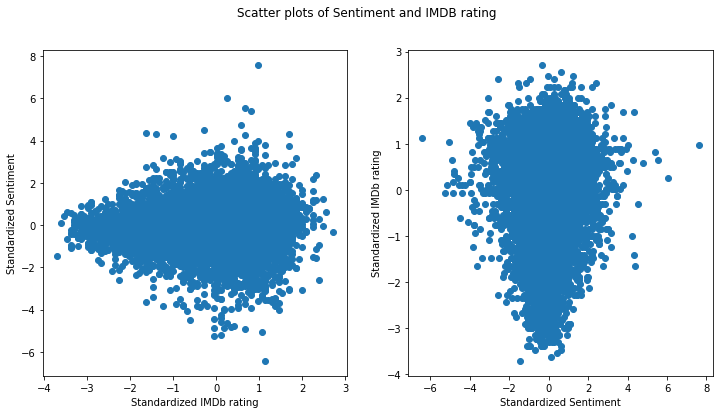

The correlation coeffiecent for the standardized sentiment compared to the standardized rating is 0.082730


In [78]:
#Calculate correlation
y = [moviesentement[key][1]/moviesentement[key][0] for key in ratingDict]
x = ratingDict.values()
y = (y-np.mean(y))/np.std(y)
x = (x-np.mean(x))/np.std(x)
figure = plt.figure(figsize=(12,6))
figure.suptitle("Scatter plots of Sentiment and IMDB rating")
plt.subplot(1,2,1)
plt.scatter(x,y)
plt.xlabel("Standardized IMDb rating")
plt.ylabel("Standardized Sentiment")
plt.subplot(1,2,2)
plt.scatter(y,x)
plt.ylabel("Standardized IMDb rating")
plt.xlabel("Standardized Sentiment")
plt.savefig("Figures/CorrelationSentiment.png")
plt.savefig("Figures/CorrelationSentiment.eps")
plt.savefig("Figures/CorrelationSentiment.svg")
plt.savefig("Figures/CorrelationSentiment.pdf")
plt.show()
print "The correlation coeffiecent for the standardized sentiment compared to the standardized rating is %f" %np.corrcoef(x,y)[0][1]

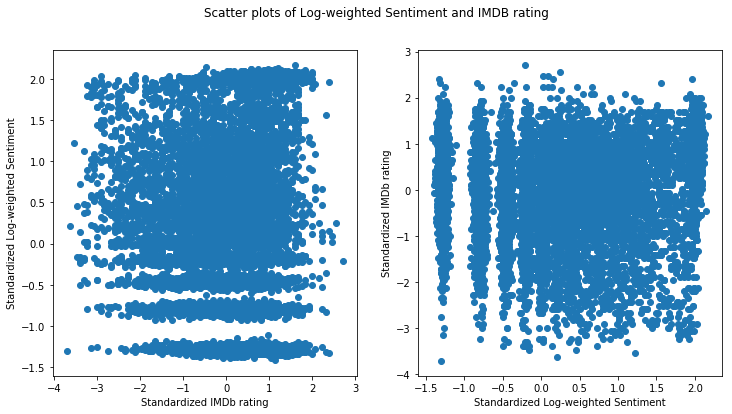

The correlation coeffiecent for the standardaized and log weighted sentiment compared to the standardized rating is -0.049917


In [79]:
#Calculate correlation with log weight
y = [moviesentement[key][1]/moviesentement[key][0]*np.log(moviesentement[key][0]+1) for key in ratingDict]
x = ratingDict.values()
y = (y-np.mean(y))/np.std(y)
x = (x-np.mean(x))/np.std(x)
figure = plt.figure(figsize=(12,6))
figure.suptitle("Scatter plots of Log-weighted Sentiment and IMDB rating")
plt.subplot(1,2,1)
plt.scatter(x,y)
plt.xlabel("Standardized IMDb rating")
plt.ylabel("Standardized Log-weighted Sentiment")
plt.subplot(1,2,2)
plt.scatter(y,x)
plt.ylabel("Standardized IMDb rating")
plt.xlabel("Standardized Log-weighted Sentiment")
plt.savefig("Figures/CorrelationSentimentLog.png")
plt.savefig("Figures/CorrelationSentimentLog.eps")
plt.savefig("Figures/CorrelationSentimentLog.svg")
plt.savefig("Figures/CorrelationSentimentLog.pdf")
plt.show()
print "The correlation coeffiecent for the standardaized and log weighted sentiment compared to the standardized rating is %f" %np.corrcoef(x,y)[0][1]

What we see as now assumed is that rating and sentiment are in no way correlated with or without weighting. This confirms our suspision that the average sentiment of reviews does not reflect if a movie is bad or good.

# Part 4: Discussion

Throughout this project multiple problems with predicting enjoyable actor groups occured. These problems occured because of the way which the sentiment analysis and finding the communities were done.

The Communities are based on the realease year of the movies the actors were generally in and the countries of the movies the actors were in. Therefore it did not find communitities of enjoyable actors, but instead countries and time periods of movies.

Another problem is that the sentiment analysis is carried out based on words which has been categorized as positive and negative in general, not necessarely for movies. Therefore movies with a negative theme were seen as negative reviews and movies with a positive theme were seen as having a lot of positive reviews.

The way which these two parts of the project were done would therefore have to be changed, in order to potentially getting a better result.

## Communities

As the project is now the communities are very large. In order to give a more precise view of certain actor groups which is enjoyable together, the communities had to be much smaller and contain only actors which actually tend to work together in a lot of movies.
In order to do this the communties had to be done in a way where only closely related actors were actualy grouped together, creating much smaller communities, but also creating communities with actors which actually tend to work together in movies, instead of getting an entire country as a community. By doing this there would also be a larger difference in sentiment scores between comunities, since actor groups would be compared instead of comparing two different countries movies to each other.

## Sentiment analysis

Instead of working with a premade list of positive and negative words, one possibility in order to make the sentiment analysis more accurate for this project, is to make a new sentiment analysis were words has been grouped as possitive and negative, especially for how words are used in movie reviews. 

This would mean that words like "scary", "murder" and "killing" would no longer be seen as negative in the moview reviews, since these are words used when describing horrormovies in general, but instead focusing at words describing the likeability of the movies.

By doing this it would decrease the bias which occures throughout this project and make the sentiment analysis more accurate when predicting enjoyable actor groups.

## Final comments

In order to make this project work as intended, both of the above changes would have to be changed, since only changing one of the would not fix the problem.

If only the communities were fixed, it might be possible to see a difference in sentiment scores between actor groups, however it would say that actors in commedies, disney movies etc would be enjoyable and actors groups which appear in horror movies would make bad movies, therefore not fixing the problem.

If only the sentiment analysis were fixed, the sentiment scores would be more accurate, however it would still only compare countries and time periods, thus not finding enjoyable actor groups.

Therefore these two changes would both have to be implemented, in order to try and find enjoyable actor groups.

# References
[Dodds, 2011] - Sheridan Dodds, P., Decker Harris, K., M Kloumann, I., A Bliss, C., & M Danforth, C. (2017). Temporal patterns of happiness and information in a global social network: hedonometrics and Twitter. Plos One.

[Orman, 2011] - Orman, G. Ã. K., Labatut, V., & Cherifi, H. (2011). On Accuracy of Community Structure Discovery Algorithms. Journal of Convergence Information Technology, 6(11